# Import relevant packages

In [1]:
# Manually add environment's bin dir to the path inside notebook to run tensorboard
import os
PATH = os.getenv('PATH')
%env PATH=/home/theghub/naureenk/.conda/envs/crev/bin:$PATH
    
# Magic command to load tensorboard extension
%load_ext tensorboard
# Mute TF 2.12 Bug Warnings (Before importing tensorflow)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 
import sys
# Appending the U-net package folder
sys.path.append("./src/")
import unet
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import losses, metrics
from tensorflow.keras.layers import Input, Conv2D, Dropout, MaxPooling2D, Activation, ReLU
from tensorflow.keras.layers import BatchNormalization, Conv2DTranspose, Concatenate
from tensorflow.keras.models import Model, Sequential
from IPython.display import Image, display
from tensorflow.keras.preprocessing.image import load_img
#keras.backend.set_image_data_format('channels_last')
import PIL
from PIL import ImageOps
print(f"Tensorflow ver. {tf.__version__}")

env: PATH=/home/theghub/naureenk/.conda/envs/crev/bin:/apps/jupyterlab70/r2/bin:/apps/share64/debian10/anaconda/anaconda-7/bin:/bin:/usr/bin:/usr/bin/X11:/sbin:/usr/sbin
Tensorflow ver. 2.12.0


## Working TF input pipeline for U-Net

In [2]:
IMG_SIZE = (512,512)
#function to read image and mask from file
def read_image(image_name):
    image = tf.io.read_file(image_name)
    image = tf.image.decode_png(image, channels=1)
    image = tf.image.resize(image, IMG_SIZE)
    image = tf.cast(image, tf.float32)/255.0
    return image
    
def read_mask(mask_name):    
    mask = tf.io.read_file(mask_name)
    mask = tf.image.decode_png(mask, channels=1)
    mask = tf.image.resize(mask, IMG_SIZE)
    mask = tf.cast(mask, tf.uint8)
    #mask = tf.expand_dims(mask, axis=-1)
    return mask

data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip("horizontal"),
  tf.keras.layers.experimental.preprocessing.RandomRotation(0.25),
  tf.keras.layers.experimental.preprocessing.RandomContrast(0.1)],
  )

# Create TRAIN TF dataset of Images and Labels separately and then map the files to stream of images and labels
train_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_median/Train/*.png", shuffle=False)
train_image_dataset = train_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)
train_label_dataset = tf.data.Dataset.list_files("./gris/Labels_512/Train/*.png", shuffle=False)
train_label_dataset = train_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)
# Combine both datasets
train_ds = tf.data.Dataset.zip((train_image_dataset,train_label_dataset))
# Add data augmentation
#train_ds = train_ds.map(lambda x, y: (data_augmentation(x, training=True), y), num_parallel_calls=tf.data.AUTOTUNE)

# Create VALIDATION TF dataset of Images and Labels separately and then map the files to stream of images and labels
valid_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_median/Valid/*.png", shuffle=False)
valid_image_dataset = valid_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)
valid_label_dataset = tf.data.Dataset.list_files("./gris/Labels_512/Valid/*.png", shuffle=False)
valid_label_dataset = valid_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)
# Combine both datasets
valid_ds = tf.data.Dataset.zip((valid_image_dataset,valid_label_dataset))
#for element in train_ds:
#    print(element)


## Build unet model with parameters

In [3]:
#LEARNING_RATE = 0.005
unet_model = unet.build_model(nx = 512, ny = 512,
                              channels=1,
                              num_classes=3,
                              layer_depth=3,
                              filters_root=16,
                              pool_size=2,
                              dropout_rate=0.1,
                              padding="same",
                              activation="relu",
                              kernel_initializer='glorot_uniform',
                              kernel_regularizer=tf.keras.regularizers.L1L2(l1=0.0, l2=0.01)
)

unet.finalize_model(unet_model,
                    loss=losses.SparseCategoricalCrossentropy(from_logits=False),
                    optimizer=tf.keras.optimizers.experimental.SGD(learning_rate=0.06, momentum=0.1),
                    #optimizer=tf.keras.optimizers.Adam(learning_rate=0.001, epsilon=0.001),
                    metrics=[tf.keras.metrics.SparseCategoricalAccuracy(),
                            tf.keras.metrics.IoU(num_classes=3,target_class_ids=[1],ignore_class=[0]),
                            tf.keras.metrics.MeanIoU(num_classes=3,ignore_class=[0])],
                    dice_coefficient=False,
                    mean_iou=False,
                    auc=False,
                    learning_rate=None)
unet_model.summary()

Model: "unet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 inputs (InputLayer)            [(None, 512, 512, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv_block (ConvBlock)         (None, 512, 512, 16  2480        ['inputs[0][0]']                 
                                )                                                                 
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 256, 256, 16  0           ['conv_block[0][0]']             
                                )                                                              

In [4]:
# To suppress unnecessary warnings
from absl import logging
logging.set_verbosity(logging.ERROR)

trainer = unet.Trainer(name="crevasse_data", tensorboard_images_callback=False)
trainer.fit(unet_model,
            train_dataset = train_ds,
            validation_dataset = valid_ds,
            epochs=600,
            batch_size=1)

1/1 [==============================] - 0s 468ms/step
Epoch 1/600
20/20 [==============================] - ETA: 0s - loss: 0.9867 - sparse_categorical_accuracy: 0.6804 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 12s 516ms/step - loss: 0.9867 - sparse_categorical_accuracy: 0.6804 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.8714 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 2/600
20/20 [==============================] - ETA: 0s - loss: 0.8157 - sparse_categorical_accuracy: 0.7050 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.8157 - sparse_categorical_accuracy: 0.7050 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.7675 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 3/600
20/20 [==============================] - ETA: 0s - loss: 0.7449 - sparse_categorical_accuracy: 0.7090 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.7449 - sparse_categorical_accuracy: 0.7090 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.6935 - val_sparse_categorical_accuracy: 0.6922 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 4/600
20/20 [==============================] - ETA: 0s - loss: 0.6941 - sparse_categorical_accuracy: 0.7338 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.6941 - sparse_categorical_accuracy: 0.7338 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.6733 - val_sparse_categorical_accuracy: 0.7106 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 5/600
20/20 [==============================] - ETA: 0s - loss: 0.6746 - sparse_categorical_accuracy: 0.7371 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.6746 - sparse_categorical_accuracy: 0.7371 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.6451 - val_sparse_categorical_accuracy: 0.7343 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 6/600
20/20 [==============================] - ETA: 0s - loss: 0.6529 - sparse_categorical_accuracy: 0.7452 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 482ms/step - loss: 0.6529 - sparse_categorical_accuracy: 0.7452 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.6174 - val_sparse_categorical_accuracy: 0.7549 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 7/600
20/20 [==============================] - ETA: 0s - loss: 0.6381 - sparse_categorical_accuracy: 0.7529 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.6381 - sparse_categorical_accuracy: 0.7529 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5868 - val_sparse_categorical_accuracy: 0.7755 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 8/600
20/20 [==============================] - ETA: 0s - loss: 0.6277 - sparse_categorical_accuracy: 0.7588 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.6277 - sparse_categorical_accuracy: 0.7588 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5653 - val_sparse_categorical_accuracy: 0.7878 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 9/600
20/20 [==============================] - ETA: 0s - loss: 0.6198 - sparse_categorical_accuracy: 0.7644 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.6198 - sparse_categorical_accuracy: 0.7644 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5539 - val_sparse_categorical_accuracy: 0.7933 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 10/600
20/20 [==============================] - ETA: 0s - loss: 0.6135 - sparse_categorical_accuracy: 0.7683 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.6135 - sparse_categorical_accuracy: 0.7683 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5473 - val_sparse_categorical_accuracy: 0.7964 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 11/600
20/20 [==============================] - ETA: 0s - loss: 0.6087 - sparse_categorical_accuracy: 0.7714 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.6087 - sparse_categorical_accuracy: 0.7714 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5429 - val_sparse_categorical_accuracy: 0.7984 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 12/600
20/20 [==============================] - ETA: 0s - loss: 0.6043 - sparse_categorical_accuracy: 0.7740 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 477ms/step - loss: 0.6043 - sparse_categorical_accuracy: 0.7740 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5391 - val_sparse_categorical_accuracy: 0.8003 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 13/600
20/20 [==============================] - ETA: 0s - loss: 0.6010 - sparse_categorical_accuracy: 0.7757 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.6010 - sparse_categorical_accuracy: 0.7757 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5346 - val_sparse_categorical_accuracy: 0.8031 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 14/600
20/20 [==============================] - ETA: 0s - loss: 0.5982 - sparse_categorical_accuracy: 0.7772 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5982 - sparse_categorical_accuracy: 0.7772 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5314 - val_sparse_categorical_accuracy: 0.8050 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 15/600
20/20 [==============================] - ETA: 0s - loss: 0.5957 - sparse_categorical_accuracy: 0.7786 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5957 - sparse_categorical_accuracy: 0.7786 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5286 - val_sparse_categorical_accuracy: 0.8065 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 16/600
20/20 [==============================] - ETA: 0s - loss: 0.5937 - sparse_categorical_accuracy: 0.7793 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5937 - sparse_categorical_accuracy: 0.7793 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5260 - val_sparse_categorical_accuracy: 0.8081 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 17/600
20/20 [==============================] - ETA: 0s - loss: 0.5917 - sparse_categorical_accuracy: 0.7801 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.5917 - sparse_categorical_accuracy: 0.7801 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5240 - val_sparse_categorical_accuracy: 0.8092 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 18/600
20/20 [==============================] - ETA: 0s - loss: 0.5897 - sparse_categorical_accuracy: 0.7810 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5897 - sparse_categorical_accuracy: 0.7810 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5221 - val_sparse_categorical_accuracy: 0.8102 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 19/600
20/20 [==============================] - ETA: 0s - loss: 0.5880 - sparse_categorical_accuracy: 0.7816 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5880 - sparse_categorical_accuracy: 0.7816 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5203 - val_sparse_categorical_accuracy: 0.8113 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 20/600
20/20 [==============================] - ETA: 0s - loss: 0.5865 - sparse_categorical_accuracy: 0.7823 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5865 - sparse_categorical_accuracy: 0.7823 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5190 - val_sparse_categorical_accuracy: 0.8119 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 21/600
20/20 [==============================] - ETA: 0s - loss: 0.5848 - sparse_categorical_accuracy: 0.7828 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5848 - sparse_categorical_accuracy: 0.7828 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5179 - val_sparse_categorical_accuracy: 0.8125 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 22/600
20/20 [==============================] - ETA: 0s - loss: 0.5835 - sparse_categorical_accuracy: 0.7834 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5835 - sparse_categorical_accuracy: 0.7834 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5166 - val_sparse_categorical_accuracy: 0.8133 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 23/600
20/20 [==============================] - ETA: 0s - loss: 0.5820 - sparse_categorical_accuracy: 0.7839 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5820 - sparse_categorical_accuracy: 0.7839 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5155 - val_sparse_categorical_accuracy: 0.8139 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 24/600
20/20 [==============================] - ETA: 0s - loss: 0.5808 - sparse_categorical_accuracy: 0.7845 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5808 - sparse_categorical_accuracy: 0.7845 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5145 - val_sparse_categorical_accuracy: 0.8145 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 25/600
20/20 [==============================] - ETA: 0s - loss: 0.5795 - sparse_categorical_accuracy: 0.7849 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 514ms/step - loss: 0.5795 - sparse_categorical_accuracy: 0.7849 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5137 - val_sparse_categorical_accuracy: 0.8147 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 26/600
20/20 [==============================] - ETA: 0s - loss: 0.5782 - sparse_categorical_accuracy: 0.7853 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5782 - sparse_categorical_accuracy: 0.7853 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5130 - val_sparse_categorical_accuracy: 0.8150 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 27/600
20/20 [==============================] - ETA: 0s - loss: 0.5773 - sparse_categorical_accuracy: 0.7856 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5773 - sparse_categorical_accuracy: 0.7856 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5123 - val_sparse_categorical_accuracy: 0.8155 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 28/600
20/20 [==============================] - ETA: 0s - loss: 0.5763 - sparse_categorical_accuracy: 0.7861 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5763 - sparse_categorical_accuracy: 0.7861 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5117 - val_sparse_categorical_accuracy: 0.8156 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 29/600
20/20 [==============================] - ETA: 0s - loss: 0.5752 - sparse_categorical_accuracy: 0.7864 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5752 - sparse_categorical_accuracy: 0.7864 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5110 - val_sparse_categorical_accuracy: 0.8159 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 30/600
20/20 [==============================] - ETA: 0s - loss: 0.5742 - sparse_categorical_accuracy: 0.7868 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5742 - sparse_categorical_accuracy: 0.7868 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5105 - val_sparse_categorical_accuracy: 0.8160 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 31/600
20/20 [==============================] - ETA: 0s - loss: 0.5732 - sparse_categorical_accuracy: 0.7871 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 539ms/step - loss: 0.5732 - sparse_categorical_accuracy: 0.7871 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5099 - val_sparse_categorical_accuracy: 0.8163 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 32/600
20/20 [==============================] - ETA: 0s - loss: 0.5723 - sparse_categorical_accuracy: 0.7873 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 455ms/step - loss: 0.5723 - sparse_categorical_accuracy: 0.7873 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5094 - val_sparse_categorical_accuracy: 0.8165 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 33/600
20/20 [==============================] - ETA: 0s - loss: 0.5712 - sparse_categorical_accuracy: 0.7878 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5712 - sparse_categorical_accuracy: 0.7878 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5090 - val_sparse_categorical_accuracy: 0.8166 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 34/600
20/20 [==============================] - ETA: 0s - loss: 0.5705 - sparse_categorical_accuracy: 0.7880 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5705 - sparse_categorical_accuracy: 0.7880 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5086 - val_sparse_categorical_accuracy: 0.8168 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 35/600
20/20 [==============================] - ETA: 0s - loss: 0.5697 - sparse_categorical_accuracy: 0.7882 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5697 - sparse_categorical_accuracy: 0.7882 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5082 - val_sparse_categorical_accuracy: 0.8168 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 36/600
20/20 [==============================] - ETA: 0s - loss: 0.5690 - sparse_categorical_accuracy: 0.7882 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5690 - sparse_categorical_accuracy: 0.7882 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5078 - val_sparse_categorical_accuracy: 0.8168 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 37/600
20/20 [==============================] - ETA: 0s - loss: 0.5682 - sparse_categorical_accuracy: 0.7886 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5682 - sparse_categorical_accuracy: 0.7886 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5075 - val_sparse_categorical_accuracy: 0.8169 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 38/600
20/20 [==============================] - ETA: 0s - loss: 0.5672 - sparse_categorical_accuracy: 0.7889 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 537ms/step - loss: 0.5672 - sparse_categorical_accuracy: 0.7889 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5071 - val_sparse_categorical_accuracy: 0.8170 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 39/600
20/20 [==============================] - ETA: 0s - loss: 0.5668 - sparse_categorical_accuracy: 0.7890 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5668 - sparse_categorical_accuracy: 0.7890 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5068 - val_sparse_categorical_accuracy: 0.8170 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 40/600
20/20 [==============================] - ETA: 0s - loss: 0.5659 - sparse_categorical_accuracy: 0.7894 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5659 - sparse_categorical_accuracy: 0.7894 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5065 - val_sparse_categorical_accuracy: 0.8170 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 41/600
20/20 [==============================] - ETA: 0s - loss: 0.5652 - sparse_categorical_accuracy: 0.7897 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5652 - sparse_categorical_accuracy: 0.7897 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5062 - val_sparse_categorical_accuracy: 0.8171 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 42/600
20/20 [==============================] - ETA: 0s - loss: 0.5645 - sparse_categorical_accuracy: 0.7899 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.5645 - sparse_categorical_accuracy: 0.7899 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5059 - val_sparse_categorical_accuracy: 0.8171 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 43/600
20/20 [==============================] - ETA: 0s - loss: 0.5639 - sparse_categorical_accuracy: 0.7899 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5639 - sparse_categorical_accuracy: 0.7899 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5057 - val_sparse_categorical_accuracy: 0.8171 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 44/600
20/20 [==============================] - ETA: 0s - loss: 0.5632 - sparse_categorical_accuracy: 0.7902 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5632 - sparse_categorical_accuracy: 0.7902 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5054 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 45/600
20/20 [==============================] - ETA: 0s - loss: 0.5628 - sparse_categorical_accuracy: 0.7903 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.5628 - sparse_categorical_accuracy: 0.7903 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5052 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 46/600
20/20 [==============================] - ETA: 0s - loss: 0.5619 - sparse_categorical_accuracy: 0.7906 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5619 - sparse_categorical_accuracy: 0.7906 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5049 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 47/600
20/20 [==============================] - ETA: 0s - loss: 0.5616 - sparse_categorical_accuracy: 0.7907 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5616 - sparse_categorical_accuracy: 0.7907 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5047 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 48/600
20/20 [==============================] - ETA: 0s - loss: 0.5608 - sparse_categorical_accuracy: 0.7908 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5608 - sparse_categorical_accuracy: 0.7908 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5044 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 49/600
20/20 [==============================] - ETA: 0s - loss: 0.5603 - sparse_categorical_accuracy: 0.7912 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5603 - sparse_categorical_accuracy: 0.7912 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5043 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 50/600
20/20 [==============================] - ETA: 0s - loss: 0.5598 - sparse_categorical_accuracy: 0.7911 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5598 - sparse_categorical_accuracy: 0.7911 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5041 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 51/600
20/20 [==============================] - ETA: 0s - loss: 0.5591 - sparse_categorical_accuracy: 0.7915 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5591 - sparse_categorical_accuracy: 0.7915 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5038 - val_sparse_categorical_accuracy: 0.8172 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 52/600
20/20 [==============================] - ETA: 0s - loss: 0.5586 - sparse_categorical_accuracy: 0.7916 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5586 - sparse_categorical_accuracy: 0.7916 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5036 - val_sparse_categorical_accuracy: 0.8173 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 53/600
20/20 [==============================] - ETA: 0s - loss: 0.5584 - sparse_categorical_accuracy: 0.7916 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.5584 - sparse_categorical_accuracy: 0.7916 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5034 - val_sparse_categorical_accuracy: 0.8173 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 54/600
20/20 [==============================] - ETA: 0s - loss: 0.5576 - sparse_categorical_accuracy: 0.7919 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5576 - sparse_categorical_accuracy: 0.7919 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5032 - val_sparse_categorical_accuracy: 0.8174 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 55/600
20/20 [==============================] - ETA: 0s - loss: 0.5570 - sparse_categorical_accuracy: 0.7919 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5570 - sparse_categorical_accuracy: 0.7919 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5030 - val_sparse_categorical_accuracy: 0.8174 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 56/600
20/20 [==============================] - ETA: 0s - loss: 0.5568 - sparse_categorical_accuracy: 0.7921 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5568 - sparse_categorical_accuracy: 0.7921 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5028 - val_sparse_categorical_accuracy: 0.8174 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 57/600
20/20 [==============================] - ETA: 0s - loss: 0.5561 - sparse_categorical_accuracy: 0.7926 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5561 - sparse_categorical_accuracy: 0.7926 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5027 - val_sparse_categorical_accuracy: 0.8175 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 58/600
20/20 [==============================] - ETA: 0s - loss: 0.5556 - sparse_categorical_accuracy: 0.7924 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5556 - sparse_categorical_accuracy: 0.7924 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5025 - val_sparse_categorical_accuracy: 0.8175 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 59/600
20/20 [==============================] - ETA: 0s - loss: 0.5552 - sparse_categorical_accuracy: 0.7926 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5552 - sparse_categorical_accuracy: 0.7926 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5023 - val_sparse_categorical_accuracy: 0.8175 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 60/600
20/20 [==============================] - ETA: 0s - loss: 0.5548 - sparse_categorical_accuracy: 0.7929 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5548 - sparse_categorical_accuracy: 0.7929 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5022 - val_sparse_categorical_accuracy: 0.8175 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 61/600
20/20 [==============================] - ETA: 0s - loss: 0.5543 - sparse_categorical_accuracy: 0.7929 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5543 - sparse_categorical_accuracy: 0.7929 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5020 - val_sparse_categorical_accuracy: 0.8176 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 62/600
20/20 [==============================] - ETA: 0s - loss: 0.5539 - sparse_categorical_accuracy: 0.7930 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 494ms/step - loss: 0.5539 - sparse_categorical_accuracy: 0.7930 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5017 - val_sparse_categorical_accuracy: 0.8177 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 63/600
20/20 [==============================] - ETA: 0s - loss: 0.5533 - sparse_categorical_accuracy: 0.7933 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5533 - sparse_categorical_accuracy: 0.7933 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5015 - val_sparse_categorical_accuracy: 0.8177 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 64/600
20/20 [==============================] - ETA: 0s - loss: 0.5530 - sparse_categorical_accuracy: 0.7932 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5530 - sparse_categorical_accuracy: 0.7932 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5014 - val_sparse_categorical_accuracy: 0.8177 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 65/600
20/20 [==============================] - ETA: 0s - loss: 0.5525 - sparse_categorical_accuracy: 0.7936 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5525 - sparse_categorical_accuracy: 0.7936 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5012 - val_sparse_categorical_accuracy: 0.8178 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 66/600
20/20 [==============================] - ETA: 0s - loss: 0.5520 - sparse_categorical_accuracy: 0.7937 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5520 - sparse_categorical_accuracy: 0.7937 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5011 - val_sparse_categorical_accuracy: 0.8179 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 67/600
20/20 [==============================] - ETA: 0s - loss: 0.5515 - sparse_categorical_accuracy: 0.7938 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5515 - sparse_categorical_accuracy: 0.7938 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5009 - val_sparse_categorical_accuracy: 0.8180 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 68/600
20/20 [==============================] - ETA: 0s - loss: 0.5513 - sparse_categorical_accuracy: 0.7940 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 507ms/step - loss: 0.5513 - sparse_categorical_accuracy: 0.7940 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5007 - val_sparse_categorical_accuracy: 0.8180 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 69/600
20/20 [==============================] - ETA: 0s - loss: 0.5508 - sparse_categorical_accuracy: 0.7942 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5508 - sparse_categorical_accuracy: 0.7942 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5005 - val_sparse_categorical_accuracy: 0.8181 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 70/600
20/20 [==============================] - ETA: 0s - loss: 0.5504 - sparse_categorical_accuracy: 0.7941 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5504 - sparse_categorical_accuracy: 0.7941 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5004 - val_sparse_categorical_accuracy: 0.8182 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 71/600
20/20 [==============================] - ETA: 0s - loss: 0.5500 - sparse_categorical_accuracy: 0.7945 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.5500 - sparse_categorical_accuracy: 0.7945 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5002 - val_sparse_categorical_accuracy: 0.8182 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 72/600
20/20 [==============================] - ETA: 0s - loss: 0.5496 - sparse_categorical_accuracy: 0.7945 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5496 - sparse_categorical_accuracy: 0.7945 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.5001 - val_sparse_categorical_accuracy: 0.8183 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 73/600
20/20 [==============================] - ETA: 0s - loss: 0.5492 - sparse_categorical_accuracy: 0.7948 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 503ms/step - loss: 0.5492 - sparse_categorical_accuracy: 0.7948 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4999 - val_sparse_categorical_accuracy: 0.8183 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 74/600
20/20 [==============================] - ETA: 0s - loss: 0.5489 - sparse_categorical_accuracy: 0.7946 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 478ms/step - loss: 0.5489 - sparse_categorical_accuracy: 0.7946 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4998 - val_sparse_categorical_accuracy: 0.8184 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 75/600
20/20 [==============================] - ETA: 0s - loss: 0.5485 - sparse_categorical_accuracy: 0.7949 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 514ms/step - loss: 0.5485 - sparse_categorical_accuracy: 0.7949 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4996 - val_sparse_categorical_accuracy: 0.8185 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 76/600
20/20 [==============================] - ETA: 0s - loss: 0.5479 - sparse_categorical_accuracy: 0.7952 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.5479 - sparse_categorical_accuracy: 0.7952 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4994 - val_sparse_categorical_accuracy: 0.8186 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 77/600
20/20 [==============================] - ETA: 0s - loss: 0.5477 - sparse_categorical_accuracy: 0.7952 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 533ms/step - loss: 0.5477 - sparse_categorical_accuracy: 0.7952 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4993 - val_sparse_categorical_accuracy: 0.8186 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 78/600
20/20 [==============================] - ETA: 0s - loss: 0.5471 - sparse_categorical_accuracy: 0.7954 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5471 - sparse_categorical_accuracy: 0.7954 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4991 - val_sparse_categorical_accuracy: 0.8187 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 79/600
20/20 [==============================] - ETA: 0s - loss: 0.5469 - sparse_categorical_accuracy: 0.7955 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5469 - sparse_categorical_accuracy: 0.7955 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4990 - val_sparse_categorical_accuracy: 0.8188 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 80/600
20/20 [==============================] - ETA: 0s - loss: 0.5466 - sparse_categorical_accuracy: 0.7956 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5466 - sparse_categorical_accuracy: 0.7956 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4989 - val_sparse_categorical_accuracy: 0.8188 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 81/600
20/20 [==============================] - ETA: 0s - loss: 0.5463 - sparse_categorical_accuracy: 0.7958 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.5463 - sparse_categorical_accuracy: 0.7958 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4988 - val_sparse_categorical_accuracy: 0.8188 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 82/600
20/20 [==============================] - ETA: 0s - loss: 0.5459 - sparse_categorical_accuracy: 0.7958 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5459 - sparse_categorical_accuracy: 0.7958 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4986 - val_sparse_categorical_accuracy: 0.8189 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 83/600
20/20 [==============================] - ETA: 0s - loss: 0.5454 - sparse_categorical_accuracy: 0.7959 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5454 - sparse_categorical_accuracy: 0.7959 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4985 - val_sparse_categorical_accuracy: 0.8189 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 84/600
20/20 [==============================] - ETA: 0s - loss: 0.5450 - sparse_categorical_accuracy: 0.7962 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 478ms/step - loss: 0.5450 - sparse_categorical_accuracy: 0.7962 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4983 - val_sparse_categorical_accuracy: 0.8190 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 85/600
20/20 [==============================] - ETA: 0s - loss: 0.5448 - sparse_categorical_accuracy: 0.7963 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5448 - sparse_categorical_accuracy: 0.7963 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4982 - val_sparse_categorical_accuracy: 0.8191 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 86/600
20/20 [==============================] - ETA: 0s - loss: 0.5444 - sparse_categorical_accuracy: 0.7965 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5444 - sparse_categorical_accuracy: 0.7965 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4981 - val_sparse_categorical_accuracy: 0.8192 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 87/600
20/20 [==============================] - ETA: 0s - loss: 0.5440 - sparse_categorical_accuracy: 0.7965 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5440 - sparse_categorical_accuracy: 0.7965 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4979 - val_sparse_categorical_accuracy: 0.8192 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 88/600
20/20 [==============================] - ETA: 0s - loss: 0.5438 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5438 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4979 - val_sparse_categorical_accuracy: 0.8193 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 89/600
20/20 [==============================] - ETA: 0s - loss: 0.5433 - sparse_categorical_accuracy: 0.7969 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5433 - sparse_categorical_accuracy: 0.7969 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4977 - val_sparse_categorical_accuracy: 0.8194 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 90/600
20/20 [==============================] - ETA: 0s - loss: 0.5431 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 513ms/step - loss: 0.5431 - sparse_categorical_accuracy: 0.7967 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4977 - val_sparse_categorical_accuracy: 0.8194 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 91/600
20/20 [==============================] - ETA: 0s - loss: 0.5426 - sparse_categorical_accuracy: 0.7972 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5426 - sparse_categorical_accuracy: 0.7972 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4976 - val_sparse_categorical_accuracy: 0.8195 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 92/600
20/20 [==============================] - ETA: 0s - loss: 0.5425 - sparse_categorical_accuracy: 0.7973 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5425 - sparse_categorical_accuracy: 0.7973 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4975 - val_sparse_categorical_accuracy: 0.8196 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 93/600
20/20 [==============================] - ETA: 0s - loss: 0.5421 - sparse_categorical_accuracy: 0.7972 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.5421 - sparse_categorical_accuracy: 0.7972 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4973 - val_sparse_categorical_accuracy: 0.8196 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 94/600
20/20 [==============================] - ETA: 0s - loss: 0.5419 - sparse_categorical_accuracy: 0.7972 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5419 - sparse_categorical_accuracy: 0.7972 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4972 - val_sparse_categorical_accuracy: 0.8196 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 95/600
20/20 [==============================] - ETA: 0s - loss: 0.5415 - sparse_categorical_accuracy: 0.7975 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5415 - sparse_categorical_accuracy: 0.7975 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4971 - val_sparse_categorical_accuracy: 0.8197 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 96/600
20/20 [==============================] - ETA: 0s - loss: 0.5414 - sparse_categorical_accuracy: 0.7975 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5414 - sparse_categorical_accuracy: 0.7975 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4971 - val_sparse_categorical_accuracy: 0.8197 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 97/600
20/20 [==============================] - ETA: 0s - loss: 0.5409 - sparse_categorical_accuracy: 0.7977 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5409 - sparse_categorical_accuracy: 0.7977 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4970 - val_sparse_categorical_accuracy: 0.8198 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 98/600
20/20 [==============================] - ETA: 0s - loss: 0.5407 - sparse_categorical_accuracy: 0.7977 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5407 - sparse_categorical_accuracy: 0.7977 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4969 - val_sparse_categorical_accuracy: 0.8198 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 99/600
20/20 [==============================] - ETA: 0s - loss: 0.5403 - sparse_categorical_accuracy: 0.7978 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5403 - sparse_categorical_accuracy: 0.7978 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4968 - val_sparse_categorical_accuracy: 0.8198 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 100/600
20/20 [==============================] - ETA: 0s - loss: 0.5400 - sparse_categorical_accuracy: 0.7980 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5400 - sparse_categorical_accuracy: 0.7980 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4966 - val_sparse_categorical_accuracy: 0.8199 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 101/600
20/20 [==============================] - 7s 327ms/step - loss: 0.5399 - sparse_categorical_accuracy: 0.7981 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4967 - val_sparse_categorical_accuracy: 0.8199 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 102/600
20/20 [==============================] - ETA: 0s - loss: 0.5395 - sparse_categorical_accuracy: 0.7982 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5395 - sparse_categorical_accuracy: 0.7982 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4966 - val_sparse_categorical_accuracy: 0.8199 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 103/600
20/20 [==============================] - ETA: 0s - loss: 0.5392 - sparse_categorical_accuracy: 0.7983 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5392 - sparse_categorical_accuracy: 0.7983 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4965 - val_sparse_categorical_accuracy: 0.8200 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 104/600
20/20 [==============================] - 7s 353ms/step - loss: 0.5391 - sparse_categorical_accuracy: 0.7984 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4965 - val_sparse_categorical_accuracy: 0.8200 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 105/600
20/20 [==============================] - ETA: 0s - loss: 0.5388 - sparse_categorical_accuracy: 0.7985 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5388 - sparse_categorical_accuracy: 0.7985 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4964 - val_sparse_categorical_accuracy: 0.8200 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 106/600
20/20 [==============================] - ETA: 0s - loss: 0.5386 - sparse_categorical_accuracy: 0.7987 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.5386 - sparse_categorical_accuracy: 0.7987 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4963 - val_sparse_categorical_accuracy: 0.8200 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 107/600
20/20 [==============================] - ETA: 0s - loss: 0.5380 - sparse_categorical_accuracy: 0.7988 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5380 - sparse_categorical_accuracy: 0.7988 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4961 - val_sparse_categorical_accuracy: 0.8201 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 108/600
20/20 [==============================] - ETA: 0s - loss: 0.5378 - sparse_categorical_accuracy: 0.7989 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5378 - sparse_categorical_accuracy: 0.7989 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4961 - val_sparse_categorical_accuracy: 0.8201 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 109/600
20/20 [==============================] - ETA: 0s - loss: 0.5378 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5378 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4961 - val_sparse_categorical_accuracy: 0.8202 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 110/600
20/20 [==============================] - ETA: 0s - loss: 0.5375 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 480ms/step - loss: 0.5375 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4959 - val_sparse_categorical_accuracy: 0.8202 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 111/600
20/20 [==============================] - ETA: 0s - loss: 0.5371 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5371 - sparse_categorical_accuracy: 0.7990 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4958 - val_sparse_categorical_accuracy: 0.8202 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 112/600
20/20 [==============================] - ETA: 0s - loss: 0.5369 - sparse_categorical_accuracy: 0.7993 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5369 - sparse_categorical_accuracy: 0.7993 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4957 - val_sparse_categorical_accuracy: 0.8203 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 113/600
20/20 [==============================] - ETA: 0s - loss: 0.5369 - sparse_categorical_accuracy: 0.7991 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5369 - sparse_categorical_accuracy: 0.7991 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4957 - val_sparse_categorical_accuracy: 0.8203 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 114/600
20/20 [==============================] - ETA: 0s - loss: 0.5365 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5365 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4957 - val_sparse_categorical_accuracy: 0.8203 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 115/600
20/20 [==============================] - ETA: 0s - loss: 0.5362 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5362 - sparse_categorical_accuracy: 0.7994 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4956 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 116/600
20/20 [==============================] - ETA: 0s - loss: 0.5358 - sparse_categorical_accuracy: 0.7997 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 483ms/step - loss: 0.5358 - sparse_categorical_accuracy: 0.7997 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4955 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 117/600
20/20 [==============================] - ETA: 0s - loss: 0.5358 - sparse_categorical_accuracy: 0.7998 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5358 - sparse_categorical_accuracy: 0.7998 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4955 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 118/600
20/20 [==============================] - ETA: 0s - loss: 0.5356 - sparse_categorical_accuracy: 0.7996 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 507ms/step - loss: 0.5356 - sparse_categorical_accuracy: 0.7996 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4953 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 119/600
20/20 [==============================] - ETA: 0s - loss: 0.5353 - sparse_categorical_accuracy: 0.7999 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5353 - sparse_categorical_accuracy: 0.7999 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4953 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 120/600
20/20 [==============================] - ETA: 0s - loss: 0.5352 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5352 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4952 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 121/600
20/20 [==============================] - ETA: 0s - loss: 0.5350 - sparse_categorical_accuracy: 0.7999 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5350 - sparse_categorical_accuracy: 0.7999 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4950 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 122/600
20/20 [==============================] - 7s 326ms/step - loss: 0.5349 - sparse_categorical_accuracy: 0.8000 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4951 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 123/600
20/20 [==============================] - ETA: 0s - loss: 0.5345 - sparse_categorical_accuracy: 0.8001 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5345 - sparse_categorical_accuracy: 0.8001 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4949 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 124/600
20/20 [==============================] - 7s 346ms/step - loss: 0.5342 - sparse_categorical_accuracy: 0.8003 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4949 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 125/600
20/20 [==============================] - ETA: 0s - loss: 0.5341 - sparse_categorical_accuracy: 0.8005 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5341 - sparse_categorical_accuracy: 0.8005 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4947 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 126/600
20/20 [==============================] - 7s 345ms/step - loss: 0.5342 - sparse_categorical_accuracy: 0.8004 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4948 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 127/600
20/20 [==============================] - 7s 328ms/step - loss: 0.5337 - sparse_categorical_accuracy: 0.8006 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4948 - val_sparse_categorical_accuracy: 0.8204 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 128/600
20/20 [==============================] - ETA: 0s - loss: 0.5335 - sparse_categorical_accuracy: 0

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5335 - sparse_categorical_accuracy: 0.8006 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4944 - val_sparse_categorical_accuracy: 0.8205 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 129/600
20/20 [==============================] - ETA: 0s - loss: 0.5334 - sparse_categorical_accuracy: 0.8007 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 481ms/step - loss: 0.5334 - sparse_categorical_accuracy: 0.8007 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4943 - val_sparse_categorical_accuracy: 0.8206 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 130/600
20/20 [==============================] - ETA: 0s - loss: 0.5333 - sparse_categorical_accuracy: 0.8007 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 482ms/step - loss: 0.5333 - sparse_categorical_accuracy: 0.8007 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4943 - val_sparse_categorical_accuracy: 0.8206 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 131/600
20/20 [==============================] - 7s 342ms/step - loss: 0.5331 - sparse_categorical_accuracy: 0.8007 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4944 - val_sparse_categorical_accuracy: 0.8206 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 132/600
20/20 [==============================] - ETA: 0s - loss: 0.5329 - sparse_categorical_accuracy: 0.8009 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5329 - sparse_categorical_accuracy: 0.8009 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4942 - val_sparse_categorical_accuracy: 0.8206 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 133/600
20/20 [==============================] - ETA: 0s - loss: 0.5327 - sparse_categorical_accuracy: 0.8009 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5327 - sparse_categorical_accuracy: 0.8009 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4941 - val_sparse_categorical_accuracy: 0.8207 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 134/600
20/20 [==============================] - ETA: 0s - loss: 0.5326 - sparse_categorical_accuracy: 0.8008 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5326 - sparse_categorical_accuracy: 0.8008 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4940 - val_sparse_categorical_accuracy: 0.8207 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 135/600
20/20 [==============================] - ETA: 0s - loss: 0.5323 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5323 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4938 - val_sparse_categorical_accuracy: 0.8208 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 136/600
20/20 [==============================] - 7s 348ms/step - loss: 0.5324 - sparse_categorical_accuracy: 0.8012 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4939 - val_sparse_categorical_accuracy: 0.8207 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 137/600
20/20 [==============================] - ETA: 0s - loss: 0.5320 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5320 - sparse_categorical_accuracy: 0.8011 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4937 - val_sparse_categorical_accuracy: 0.8208 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 138/600
20/20 [==============================] - ETA: 0s - loss: 0.5316 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5316 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4935 - val_sparse_categorical_accuracy: 0.8208 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 139/600
20/20 [==============================] - 7s 352ms/step - loss: 0.5318 - sparse_categorical_accuracy: 0.8013 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4935 - val_sparse_categorical_accuracy: 0.8209 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 140/600
20/20 [==============================] - ETA: 0s - loss: 0.5313 - sparse_categorical_accuracy: 0.8013 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5313 - sparse_categorical_accuracy: 0.8013 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4931 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 141/600
20/20 [==============================] - 7s 340ms/step - loss: 0.5313 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4932 - val_sparse_categorical_accuracy: 0.8208 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 142/600
20/20 [==============================] - ETA: 0s - loss: 0.5308 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5308 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4930 - val_sparse_categorical_accuracy: 0.8209 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 143/600
20/20 [==============================] - 7s 337ms/step - loss: 0.5312 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4930 - val_sparse_categorical_accuracy: 0.8209 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 144/600
20/20 [==============================] - 7s 340ms/step - loss: 0.5311 - sparse_categorical_accuracy: 0.8014 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4931 - val_sparse_categorical_accuracy: 0.8209 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 145/600
20/20 [==============================] - ETA: 0s - loss: 0.5306 - sparse_categorical_accuracy: 0

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5306 - sparse_categorical_accuracy: 0.8018 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4927 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 146/600
20/20 [==============================] - ETA: 0s - loss: 0.5303 - sparse_categorical_accuracy: 0.8018 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5303 - sparse_categorical_accuracy: 0.8018 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4926 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 147/600
20/20 [==============================] - ETA: 0s - loss: 0.5305 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5305 - sparse_categorical_accuracy: 0.8016 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4925 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 148/600
20/20 [==============================] - ETA: 0s - loss: 0.5304 - sparse_categorical_accuracy: 0.8019 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 504ms/step - loss: 0.5304 - sparse_categorical_accuracy: 0.8019 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4924 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 149/600
20/20 [==============================] - ETA: 0s - loss: 0.5298 - sparse_categorical_accuracy: 0.8021 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5298 - sparse_categorical_accuracy: 0.8021 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4922 - val_sparse_categorical_accuracy: 0.8211 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 150/600
20/20 [==============================] - 6s 317ms/step - loss: 0.5299 - sparse_categorical_accuracy: 0.8020 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4922 - val_sparse_categorical_accuracy: 0.8210 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 151/600
20/20 [==============================] - ETA: 0s - loss: 0.5297 - sparse_categorical_accuracy: 0.8020 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 480ms/step - loss: 0.5297 - sparse_categorical_accuracy: 0.8020 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4920 - val_sparse_categorical_accuracy: 0.8211 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 152/600
20/20 [==============================] - ETA: 0s - loss: 0.5294 - sparse_categorical_accuracy: 0.8023 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5294 - sparse_categorical_accuracy: 0.8023 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4917 - val_sparse_categorical_accuracy: 0.8212 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 153/600
20/20 [==============================] - ETA: 0s - loss: 0.5292 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.5292 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4915 - val_sparse_categorical_accuracy: 0.8212 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 154/600
20/20 [==============================] - 7s 334ms/step - loss: 0.5292 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4917 - val_sparse_categorical_accuracy: 0.8211 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 155/600
20/20 [==============================] - ETA: 0s - loss: 0.5291 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 503ms/step - loss: 0.5291 - sparse_categorical_accuracy: 0.8022 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4913 - val_sparse_categorical_accuracy: 0.8212 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 156/600
20/20 [==============================] - 7s 329ms/step - loss: 0.5287 - sparse_categorical_accuracy: 0.8023 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4916 - val_sparse_categorical_accuracy: 0.8211 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 157/600
20/20 [==============================] - ETA: 0s - loss: 0.5285 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5285 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4911 - val_sparse_categorical_accuracy: 0.8212 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 158/600
20/20 [==============================] - ETA: 0s - loss: 0.5286 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5286 - sparse_categorical_accuracy: 0.8024 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4909 - val_sparse_categorical_accuracy: 0.8213 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 159/600
20/20 [==============================] - ETA: 0s - loss: 0.5285 - sparse_categorical_accuracy: 0.8025 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5285 - sparse_categorical_accuracy: 0.8025 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4908 - val_sparse_categorical_accuracy: 0.8213 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 160/600
20/20 [==============================] - ETA: 0s - loss: 0.5282 - sparse_categorical_accuracy: 0.8025 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5282 - sparse_categorical_accuracy: 0.8025 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4907 - val_sparse_categorical_accuracy: 0.8214 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 161/600
20/20 [==============================] - ETA: 0s - loss: 0.5279 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5279 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4905 - val_sparse_categorical_accuracy: 0.8214 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 162/600
20/20 [==============================] - ETA: 0s - loss: 0.5280 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5280 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4902 - val_sparse_categorical_accuracy: 0.8216 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 163/600
20/20 [==============================] - ETA: 0s - loss: 0.5278 - sparse_categorical_accuracy: 0.8027 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5278 - sparse_categorical_accuracy: 0.8027 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4899 - val_sparse_categorical_accuracy: 0.8216 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 164/600
20/20 [==============================] - 7s 327ms/step - loss: 0.5278 - sparse_categorical_accuracy: 0.8028 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4900 - val_sparse_categorical_accuracy: 0.8216 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 165/600
20/20 [==============================] - ETA: 0s - loss: 0.5278 - sparse_categorical_accuracy: 0.8027 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5278 - sparse_categorical_accuracy: 0.8027 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4897 - val_sparse_categorical_accuracy: 0.8216 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 166/600
20/20 [==============================] - ETA: 0s - loss: 0.5273 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5273 - sparse_categorical_accuracy: 0.8026 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4895 - val_sparse_categorical_accuracy: 0.8217 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 167/600
20/20 [==============================] - ETA: 0s - loss: 0.5273 - sparse_categorical_accuracy: 0.8029 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.5273 - sparse_categorical_accuracy: 0.8029 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4894 - val_sparse_categorical_accuracy: 0.8217 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 168/600
20/20 [==============================] - ETA: 0s - loss: 0.5272 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5272 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4892 - val_sparse_categorical_accuracy: 0.8217 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 169/600
20/20 [==============================] - ETA: 0s - loss: 0.5268 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 458ms/step - loss: 0.5268 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4889 - val_sparse_categorical_accuracy: 0.8218 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 170/600
20/20 [==============================] - ETA: 0s - loss: 0.5268 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5268 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4887 - val_sparse_categorical_accuracy: 0.8219 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 171/600
20/20 [==============================] - 7s 350ms/step - loss: 0.5268 - sparse_categorical_accuracy: 0.8030 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4888 - val_sparse_categorical_accuracy: 0.8218 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 172/600
20/20 [==============================] - ETA: 0s - loss: 0.5264 - sparse_categorical_accuracy: 0.8031 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5264 - sparse_categorical_accuracy: 0.8031 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4883 - val_sparse_categorical_accuracy: 0.8219 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 173/600
20/20 [==============================] - 7s 335ms/step - loss: 0.5265 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4885 - val_sparse_categorical_accuracy: 0.8219 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 174/600
20/20 [==============================] - ETA: 0s - loss: 0.5264 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.5264 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4883 - val_sparse_categorical_accuracy: 0.8220 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 175/600
20/20 [==============================] - ETA: 0s - loss: 0.5261 - sparse_categorical_accuracy: 0.8033 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5261 - sparse_categorical_accuracy: 0.8033 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4878 - val_sparse_categorical_accuracy: 0.8220 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 176/600
20/20 [==============================] - ETA: 0s - loss: 0.5261 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5261 - sparse_categorical_accuracy: 0.8032 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4878 - val_sparse_categorical_accuracy: 0.8221 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 177/600
20/20 [==============================] - ETA: 0s - loss: 0.5261 - sparse_categorical_accuracy: 0.8034 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5261 - sparse_categorical_accuracy: 0.8034 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4876 - val_sparse_categorical_accuracy: 0.8220 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 178/600
20/20 [==============================] - ETA: 0s - loss: 0.5256 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5256 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4873 - val_sparse_categorical_accuracy: 0.8223 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 179/600
20/20 [==============================] - ETA: 0s - loss: 0.5260 - sparse_categorical_accuracy: 0.8034 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 519ms/step - loss: 0.5260 - sparse_categorical_accuracy: 0.8034 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4871 - val_sparse_categorical_accuracy: 0.8222 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 180/600
20/20 [==============================] - ETA: 0s - loss: 0.5254 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5254 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4869 - val_sparse_categorical_accuracy: 0.8223 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 181/600
20/20 [==============================] - ETA: 0s - loss: 0.5256 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5256 - sparse_categorical_accuracy: 0.8035 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4869 - val_sparse_categorical_accuracy: 0.8223 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 182/600
20/20 [==============================] - ETA: 0s - loss: 0.5254 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5254 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4868 - val_sparse_categorical_accuracy: 0.8222 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 183/600
20/20 [==============================] - ETA: 0s - loss: 0.5250 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5250 - sparse_categorical_accuracy: 0.8036 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4866 - val_sparse_categorical_accuracy: 0.8223 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 184/600
20/20 [==============================] - ETA: 0s - loss: 0.5253 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.5253 - sparse_categorical_accuracy: 0.8037 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4863 - val_sparse_categorical_accuracy: 0.8223 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 185/600
20/20 [==============================] - ETA: 0s - loss: 0.5249 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5249 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4861 - val_sparse_categorical_accuracy: 0.8225 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 186/600
20/20 [==============================] - ETA: 0s - loss: 0.5248 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 494ms/step - loss: 0.5248 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4860 - val_sparse_categorical_accuracy: 0.8224 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 187/600
20/20 [==============================] - ETA: 0s - loss: 0.5246 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5246 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4857 - val_sparse_categorical_accuracy: 0.8224 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 188/600
20/20 [==============================] - ETA: 0s - loss: 0.5247 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5247 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4856 - val_sparse_categorical_accuracy: 0.8225 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 189/600
20/20 [==============================] - ETA: 0s - loss: 0.5245 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5245 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4853 - val_sparse_categorical_accuracy: 0.8225 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 190/600
20/20 [==============================] - ETA: 0s - loss: 0.5242 - sparse_categorical_accuracy: 0.8040 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5242 - sparse_categorical_accuracy: 0.8040 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4853 - val_sparse_categorical_accuracy: 0.8225 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 191/600
20/20 [==============================] - ETA: 0s - loss: 0.5245 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5245 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4851 - val_sparse_categorical_accuracy: 0.8226 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 192/600
20/20 [==============================] - ETA: 0s - loss: 0.5242 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5242 - sparse_categorical_accuracy: 0.8038 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4849 - val_sparse_categorical_accuracy: 0.8227 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 193/600
20/20 [==============================] - ETA: 0s - loss: 0.5240 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.5240 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4844 - val_sparse_categorical_accuracy: 0.8228 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 194/600
20/20 [==============================] - ETA: 0s - loss: 0.5238 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5238 - sparse_categorical_accuracy: 0.8041 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4843 - val_sparse_categorical_accuracy: 0.8228 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 195/600
20/20 [==============================] - 7s 332ms/step - loss: 0.5235 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4846 - val_sparse_categorical_accuracy: 0.8227 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 196/600
20/20 [==============================] - 7s 337ms/step - loss: 0.5237 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4844 - val_sparse_categorical_accuracy: 0.8227 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 197/600
20/20 [==============================] - ETA: 0s - loss: 0.5236 - sparse_categorical_accuracy: 0.

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5236 - sparse_categorical_accuracy: 0.8039 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4840 - val_sparse_categorical_accuracy: 0.8229 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 198/600
20/20 [==============================] - ETA: 0s - loss: 0.5234 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5234 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4837 - val_sparse_categorical_accuracy: 0.8229 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 199/600
20/20 [==============================] - ETA: 0s - loss: 0.5234 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5234 - sparse_categorical_accuracy: 0.8042 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4836 - val_sparse_categorical_accuracy: 0.8230 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 200/600
20/20 [==============================] - ETA: 0s - loss: 0.5233 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5233 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4835 - val_sparse_categorical_accuracy: 0.8229 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 201/600
20/20 [==============================] - ETA: 0s - loss: 0.5233 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 482ms/step - loss: 0.5233 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4832 - val_sparse_categorical_accuracy: 0.8230 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 202/600
20/20 [==============================] - ETA: 0s - loss: 0.5231 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5231 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4832 - val_sparse_categorical_accuracy: 0.8230 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 203/600
20/20 [==============================] - ETA: 0s - loss: 0.5231 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5231 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4829 - val_sparse_categorical_accuracy: 0.8231 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 204/600
20/20 [==============================] - ETA: 0s - loss: 0.5229 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.5229 - sparse_categorical_accuracy: 0.8044 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4825 - val_sparse_categorical_accuracy: 0.8232 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 205/600
20/20 [==============================] - 7s 321ms/step - loss: 0.5229 - sparse_categorical_accuracy: 0.8045 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4826 - val_sparse_categorical_accuracy: 0.8231 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 206/600
20/20 [==============================] - ETA: 0s - loss: 0.5225 - sparse_categorical_accuracy: 0.8045 - io_u: 8.2924e-07 - mean_io_u: 2.7641e-07INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5225 - sparse_categorical_accuracy: 0.8045 - io_u: 8.2924e-07 - mean_io_u: 2.7641e-07 - val_loss: 0.4823 - val_sparse_categorical_accuracy: 0.8232 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 207/600
20/20 [==============================] - ETA: 0s - loss: 0.5227 - sparse_categorical_accuracy: 0.8046 - io_u: 3.3170e-06 - mean_io_u: 1.1057e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.5227 - sparse_categorical_accuracy: 0.8046 - io_u: 3.3170e-06 - mean_io_u: 1.1057e-06 - val_loss: 0.4823 - val_sparse_categorical_accuracy: 0.8232 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 208/600
20/20 [==============================] - ETA: 0s - loss: 0.5221 - sparse_categorical_accuracy: 0.8048 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 512ms/step - loss: 0.5221 - sparse_categorical_accuracy: 0.8048 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4817 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 209/600
20/20 [==============================] - 7s 344ms/step - loss: 0.5223 - sparse_categorical_accuracy: 0.8047 - io_u: 2.4877e-06 - mean_io_u: 8.2924e-07 - val_loss: 0.4820 - val_sparse_categorical_accuracy: 0.8232 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 210/600
20/20 [==============================] - ETA: 0s - loss: 0.5219 - sparse_categorical_accuracy: 0.8049 - io_u: 3.3170e-06 - mean_io_u: 1.1057e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5219 - sparse_categorical_accuracy: 0.8049 - io_u: 3.3170e-06 - mean_io_u: 1.1057e-06 - val_loss: 0.4816 - val_sparse_categorical_accuracy: 0.8234 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 211/600
20/20 [==============================] - 7s 348ms/step - loss: 0.5221 - sparse_categorical_accuracy: 0.8048 - io_u: 0.0000e+00 - mean_io_u: 0.0000e+00 - val_loss: 0.4818 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 212/600
20/20 [==============================] - 7s 353ms/step - loss: 0.5220 - sparse_categorical_accuracy: 0.8048 - io_u: 8.2924e-07 - mean_io_u: 2.7641e-07 - val_loss: 0.4818 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 213/600
20/20 [==============================] - ETA: 0s - loss: 0.5218 - sparse_categorical_accuracy: 0.

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.5218 - sparse_categorical_accuracy: 0.8050 - io_u: 4.1462e-06 - mean_io_u: 1.3821e-06 - val_loss: 0.4813 - val_sparse_categorical_accuracy: 0.8233 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 214/600
20/20 [==============================] - ETA: 0s - loss: 0.5218 - sparse_categorical_accuracy: 0.8048 - io_u: 9.9509e-06 - mean_io_u: 3.3170e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5218 - sparse_categorical_accuracy: 0.8048 - io_u: 9.9509e-06 - mean_io_u: 3.3170e-06 - val_loss: 0.4811 - val_sparse_categorical_accuracy: 0.8234 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 215/600
20/20 [==============================] - ETA: 0s - loss: 0.5217 - sparse_categorical_accuracy: 0.8049 - io_u: 9.9509e-06 - mean_io_u: 3.3170e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5217 - sparse_categorical_accuracy: 0.8049 - io_u: 9.9509e-06 - mean_io_u: 3.3170e-06 - val_loss: 0.4807 - val_sparse_categorical_accuracy: 0.8235 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 216/600
20/20 [==============================] - 6s 309ms/step - loss: 0.5217 - sparse_categorical_accuracy: 0.8049 - io_u: 3.3170e-06 - mean_io_u: 1.1057e-06 - val_loss: 0.4807 - val_sparse_categorical_accuracy: 0.8235 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 217/600
20/20 [==============================] - ETA: 0s - loss: 0.5216 - sparse_categorical_accuracy: 0.8050 - io_u: 1.5756e-05 - mean_io_u: 5.2519e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5216 - sparse_categorical_accuracy: 0.8050 - io_u: 1.5756e-05 - mean_io_u: 5.2519e-06 - val_loss: 0.4805 - val_sparse_categorical_accuracy: 0.8236 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 218/600
20/20 [==============================] - ETA: 0s - loss: 0.5214 - sparse_categorical_accuracy: 0.8051 - io_u: 6.6339e-06 - mean_io_u: 2.2113e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5214 - sparse_categorical_accuracy: 0.8051 - io_u: 6.6339e-06 - mean_io_u: 2.2113e-06 - val_loss: 0.4804 - val_sparse_categorical_accuracy: 0.8235 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 219/600
20/20 [==============================] - ETA: 0s - loss: 0.5215 - sparse_categorical_accuracy: 0.8050 - io_u: 1.3268e-05 - mean_io_u: 4.4226e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5215 - sparse_categorical_accuracy: 0.8050 - io_u: 1.3268e-05 - mean_io_u: 4.4226e-06 - val_loss: 0.4804 - val_sparse_categorical_accuracy: 0.8235 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 220/600
20/20 [==============================] - ETA: 0s - loss: 0.5212 - sparse_categorical_accuracy: 0.8051 - io_u: 2.3219e-05 - mean_io_u: 7.7396e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 478ms/step - loss: 0.5212 - sparse_categorical_accuracy: 0.8051 - io_u: 2.3219e-05 - mean_io_u: 7.7396e-06 - val_loss: 0.4804 - val_sparse_categorical_accuracy: 0.8236 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 221/600
20/20 [==============================] - ETA: 0s - loss: 0.5212 - sparse_categorical_accuracy: 0.8052 - io_u: 2.4877e-05 - mean_io_u: 8.2923e-06INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5212 - sparse_categorical_accuracy: 0.8052 - io_u: 2.4877e-05 - mean_io_u: 8.2923e-06 - val_loss: 0.4800 - val_sparse_categorical_accuracy: 0.8237 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 222/600
20/20 [==============================] - ETA: 0s - loss: 0.5212 - sparse_categorical_accuracy: 0.8051 - io_u: 3.8145e-05 - mean_io_u: 1.2715e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5212 - sparse_categorical_accuracy: 0.8051 - io_u: 3.8145e-05 - mean_io_u: 1.2715e-05 - val_loss: 0.4800 - val_sparse_categorical_accuracy: 0.8237 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 223/600
20/20 [==============================] - ETA: 0s - loss: 0.5208 - sparse_categorical_accuracy: 0.8054 - io_u: 4.4778e-05 - mean_io_u: 1.4926e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 502ms/step - loss: 0.5208 - sparse_categorical_accuracy: 0.8054 - io_u: 4.4778e-05 - mean_io_u: 1.4926e-05 - val_loss: 0.4797 - val_sparse_categorical_accuracy: 0.8238 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 224/600
20/20 [==============================] - ETA: 0s - loss: 0.5210 - sparse_categorical_accuracy: 0.8053 - io_u: 5.2241e-05 - mean_io_u: 1.7414e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 520ms/step - loss: 0.5210 - sparse_categorical_accuracy: 0.8053 - io_u: 5.2241e-05 - mean_io_u: 1.7414e-05 - val_loss: 0.4795 - val_sparse_categorical_accuracy: 0.8238 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 225/600
20/20 [==============================] - ETA: 0s - loss: 0.5207 - sparse_categorical_accuracy: 0.8053 - io_u: 6.2191e-05 - mean_io_u: 2.0730e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 504ms/step - loss: 0.5207 - sparse_categorical_accuracy: 0.8053 - io_u: 6.2191e-05 - mean_io_u: 2.0730e-05 - val_loss: 0.4792 - val_sparse_categorical_accuracy: 0.8239 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 226/600
20/20 [==============================] - 7s 357ms/step - loss: 0.5207 - sparse_categorical_accuracy: 0.8054 - io_u: 8.7897e-05 - mean_io_u: 2.9299e-05 - val_loss: 0.4793 - val_sparse_categorical_accuracy: 0.8239 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 227/600
20/20 [==============================] - 7s 355ms/step - loss: 0.5207 - sparse_categorical_accuracy: 0.8053 - io_u: 1.0033e-04 - mean_io_u: 3.3445e-05 - val_loss: 0.4792 - val_sparse_categorical_accuracy: 0.8238 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 228/600
20/20 [==============================] - ETA: 0s - loss: 0.5206 - sparse_categorical_accuracy: 0

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5206 - sparse_categorical_accuracy: 0.8055 - io_u: 1.2936e-04 - mean_io_u: 4.3119e-05 - val_loss: 0.4792 - val_sparse_categorical_accuracy: 0.8238 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 229/600
20/20 [==============================] - ETA: 0s - loss: 0.5206 - sparse_categorical_accuracy: 0.8056 - io_u: 1.2272e-04 - mean_io_u: 4.0908e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5206 - sparse_categorical_accuracy: 0.8056 - io_u: 1.2272e-04 - mean_io_u: 4.0908e-05 - val_loss: 0.4789 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 230/600
20/20 [==============================] - ETA: 0s - loss: 0.5206 - sparse_categorical_accuracy: 0.8053 - io_u: 1.7579e-04 - mean_io_u: 5.8597e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 547ms/step - loss: 0.5206 - sparse_categorical_accuracy: 0.8053 - io_u: 1.7579e-04 - mean_io_u: 5.8597e-05 - val_loss: 0.4788 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 231/600
20/20 [==============================] - ETA: 0s - loss: 0.5203 - sparse_categorical_accuracy: 0.8056 - io_u: 1.8491e-04 - mean_io_u: 6.1635e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 564ms/step - loss: 0.5203 - sparse_categorical_accuracy: 0.8056 - io_u: 1.8491e-04 - mean_io_u: 6.1635e-05 - val_loss: 0.4788 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 232/600
20/20 [==============================] - ETA: 0s - loss: 0.5202 - sparse_categorical_accuracy: 0.8056 - io_u: 2.5041e-04 - mean_io_u: 8.3470e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5202 - sparse_categorical_accuracy: 0.8056 - io_u: 2.5041e-04 - mean_io_u: 8.3470e-05 - val_loss: 0.4785 - val_sparse_categorical_accuracy: 0.8240 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 233/600
20/20 [==============================] - ETA: 0s - loss: 0.5204 - sparse_categorical_accuracy: 0.8055 - io_u: 2.7031e-04 - mean_io_u: 9.0103e-05INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 504ms/step - loss: 0.5204 - sparse_categorical_accuracy: 0.8055 - io_u: 2.7031e-04 - mean_io_u: 9.0103e-05 - val_loss: 0.4783 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 234/600
20/20 [==============================] - ETA: 0s - loss: 0.5202 - sparse_categorical_accuracy: 0.8055 - io_u: 3.0348e-04 - mean_io_u: 1.0116e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 12s 611ms/step - loss: 0.5202 - sparse_categorical_accuracy: 0.8055 - io_u: 3.0348e-04 - mean_io_u: 1.0116e-04 - val_loss: 0.4782 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 235/600
20/20 [==============================] - ETA: 0s - loss: 0.5197 - sparse_categorical_accuracy: 0.8058 - io_u: 3.1176e-04 - mean_io_u: 1.0392e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 528ms/step - loss: 0.5197 - sparse_categorical_accuracy: 0.8058 - io_u: 3.1176e-04 - mean_io_u: 1.0392e-04 - val_loss: 0.4781 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 236/600
20/20 [==============================] - ETA: 0s - loss: 0.5199 - sparse_categorical_accuracy: 0.8058 - io_u: 4.0048e-04 - mean_io_u: 1.3349e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 530ms/step - loss: 0.5199 - sparse_categorical_accuracy: 0.8058 - io_u: 4.0048e-04 - mean_io_u: 1.3349e-04 - val_loss: 0.4781 - val_sparse_categorical_accuracy: 0.8241 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 237/600
20/20 [==============================] - ETA: 0s - loss: 0.5198 - sparse_categorical_accuracy: 0.8058 - io_u: 4.9085e-04 - mean_io_u: 1.6362e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 504ms/step - loss: 0.5198 - sparse_categorical_accuracy: 0.8058 - io_u: 4.9085e-04 - mean_io_u: 1.6362e-04 - val_loss: 0.4778 - val_sparse_categorical_accuracy: 0.8242 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 238/600
20/20 [==============================] - ETA: 0s - loss: 0.5197 - sparse_categorical_accuracy: 0.8058 - io_u: 5.1736e-04 - mean_io_u: 1.7245e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 478ms/step - loss: 0.5197 - sparse_categorical_accuracy: 0.8058 - io_u: 5.1736e-04 - mean_io_u: 1.7245e-04 - val_loss: 0.4775 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 239/600
20/20 [==============================] - ETA: 0s - loss: 0.5197 - sparse_categorical_accuracy: 0.8056 - io_u: 7.0558e-04 - mean_io_u: 2.3519e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.5197 - sparse_categorical_accuracy: 0.8056 - io_u: 7.0558e-04 - mean_io_u: 2.3519e-04 - val_loss: 0.4772 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 240/600
20/20 [==============================] - 7s 352ms/step - loss: 0.5196 - sparse_categorical_accuracy: 0.8059 - io_u: 6.1020e-04 - mean_io_u: 2.0340e-04 - val_loss: 0.4774 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 241/600
20/20 [==============================] - 7s 352ms/step - loss: 0.5195 - sparse_categorical_accuracy: 0.8059 - io_u: 8.6552e-04 - mean_io_u: 2.8851e-04 - val_loss: 0.4773 - val_sparse_categorical_accuracy: 0.8244 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 242/600
20/20 [==============================] - ETA: 0s - loss: 0.5195 - sparse_categorical_accuracy: 0

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5195 - sparse_categorical_accuracy: 0.8058 - io_u: 9.2026e-04 - mean_io_u: 3.0675e-04 - val_loss: 0.4771 - val_sparse_categorical_accuracy: 0.8245 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 243/600
20/20 [==============================] - ETA: 0s - loss: 0.5194 - sparse_categorical_accuracy: 0.8058 - io_u: 9.1195e-04 - mean_io_u: 3.0398e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 490ms/step - loss: 0.5194 - sparse_categorical_accuracy: 0.8058 - io_u: 9.1195e-04 - mean_io_u: 3.0398e-04 - val_loss: 0.4771 - val_sparse_categorical_accuracy: 0.8245 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 244/600
20/20 [==============================] - ETA: 0s - loss: 0.5192 - sparse_categorical_accuracy: 0.8060 - io_u: 0.0010 - mean_io_u: 3.4516e-04  INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5192 - sparse_categorical_accuracy: 0.8060 - io_u: 0.0010 - mean_io_u: 3.4516e-04 - val_loss: 0.4770 - val_sparse_categorical_accuracy: 0.8245 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 245/600
20/20 [==============================] - ETA: 0s - loss: 0.5192 - sparse_categorical_accuracy: 0.8060 - io_u: 0.0011 - mean_io_u: 3.7635e-04  INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5192 - sparse_categorical_accuracy: 0.8060 - io_u: 0.0011 - mean_io_u: 3.7635e-04 - val_loss: 0.4768 - val_sparse_categorical_accuracy: 0.8246 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 246/600
20/20 [==============================] - ETA: 0s - loss: 0.5194 - sparse_categorical_accuracy: 0.8059 - io_u: 0.0014 - mean_io_u: 4.5149e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5194 - sparse_categorical_accuracy: 0.8059 - io_u: 0.0014 - mean_io_u: 4.5149e-04 - val_loss: 0.4768 - val_sparse_categorical_accuracy: 0.8246 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 247/600
20/20 [==============================] - ETA: 0s - loss: 0.5191 - sparse_categorical_accuracy: 0.8061 - io_u: 0.0014 - mean_io_u: 4.6562e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5191 - sparse_categorical_accuracy: 0.8061 - io_u: 0.0014 - mean_io_u: 4.6562e-04 - val_loss: 0.4767 - val_sparse_categorical_accuracy: 0.8246 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 248/600
20/20 [==============================] - ETA: 0s - loss: 0.5187 - sparse_categorical_accuracy: 0.8062 - io_u: 0.0016 - mean_io_u: 5.2249e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5187 - sparse_categorical_accuracy: 0.8062 - io_u: 0.0016 - mean_io_u: 5.2249e-04 - val_loss: 0.4764 - val_sparse_categorical_accuracy: 0.8247 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 249/600
20/20 [==============================] - 7s 367ms/step - loss: 0.5191 - sparse_categorical_accuracy: 0.8062 - io_u: 0.0017 - mean_io_u: 5.6996e-04 - val_loss: 0.4764 - val_sparse_categorical_accuracy: 0.8246 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 250/600
20/20 [==============================] - ETA: 0s - loss: 0.5191 - sparse_categorical_accuracy: 0.8060 - io_u: 0.0018 - mean_io_u: 6.0066e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.5191 - sparse_categorical_accuracy: 0.8060 - io_u: 0.0018 - mean_io_u: 6.0066e-04 - val_loss: 0.4763 - val_sparse_categorical_accuracy: 0.8246 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 251/600
20/20 [==============================] - ETA: 0s - loss: 0.5187 - sparse_categorical_accuracy: 0.8064 - io_u: 0.0020 - mean_io_u: 6.7551e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5187 - sparse_categorical_accuracy: 0.8064 - io_u: 0.0020 - mean_io_u: 6.7551e-04 - val_loss: 0.4761 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 252/600
20/20 [==============================] - 7s 357ms/step - loss: 0.5189 - sparse_categorical_accuracy: 0.8062 - io_u: 0.0021 - mean_io_u: 6.9403e-04 - val_loss: 0.4761 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 253/600
20/20 [==============================] - ETA: 0s - loss: 0.5187 - sparse_categorical_accuracy: 0.8063 - io_u: 0.0023 - mean_io_u: 7.6252e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5187 - sparse_categorical_accuracy: 0.8063 - io_u: 0.0023 - mean_io_u: 7.6252e-04 - val_loss: 0.4759 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 254/600
20/20 [==============================] - ETA: 0s - loss: 0.5186 - sparse_categorical_accuracy: 0.8062 - io_u: 0.0022 - mean_io_u: 7.3538e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.5186 - sparse_categorical_accuracy: 0.8062 - io_u: 0.0022 - mean_io_u: 7.3538e-04 - val_loss: 0.4758 - val_sparse_categorical_accuracy: 0.8248 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 255/600
20/20 [==============================] - ETA: 0s - loss: 0.5184 - sparse_categorical_accuracy: 0.8063 - io_u: 0.0028 - mean_io_u: 9.1769e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5184 - sparse_categorical_accuracy: 0.8063 - io_u: 0.0028 - mean_io_u: 9.1769e-04 - val_loss: 0.4755 - val_sparse_categorical_accuracy: 0.8249 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 256/600
20/20 [==============================] - ETA: 0s - loss: 0.5184 - sparse_categorical_accuracy: 0.8065 - io_u: 0.0028 - mean_io_u: 9.2240e-04INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5184 - sparse_categorical_accuracy: 0.8065 - io_u: 0.0028 - mean_io_u: 9.2240e-04 - val_loss: 0.4755 - val_sparse_categorical_accuracy: 0.8249 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 257/600
20/20 [==============================] - 7s 358ms/step - loss: 0.5183 - sparse_categorical_accuracy: 0.8065 - io_u: 0.0030 - mean_io_u: 9.8968e-04 - val_loss: 0.4756 - val_sparse_categorical_accuracy: 0.8249 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 258/600
20/20 [==============================] - ETA: 0s - loss: 0.5181 - sparse_categorical_accuracy: 0.8065 - io_u: 0.0032 - mean_io_u: 0.0011  INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.5181 - sparse_categorical_accuracy: 0.8065 - io_u: 0.0032 - mean_io_u: 0.0011 - val_loss: 0.4753 - val_sparse_categorical_accuracy: 0.8249 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 259/600
20/20 [==============================] - 7s 347ms/step - loss: 0.5181 - sparse_categorical_accuracy: 0.8064 - io_u: 0.0036 - mean_io_u: 0.0012 - val_loss: 0.4754 - val_sparse_categorical_accuracy: 0.8250 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 260/600
20/20 [==============================] - ETA: 0s - loss: 0.5181 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0036 - mean_io_u: 0.0012INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.5181 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0036 - mean_io_u: 0.0012 - val_loss: 0.4752 - val_sparse_categorical_accuracy: 0.8250 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 261/600
20/20 [==============================] - ETA: 0s - loss: 0.5178 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0040 - mean_io_u: 0.0013INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5178 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0040 - mean_io_u: 0.0013 - val_loss: 0.4752 - val_sparse_categorical_accuracy: 0.8250 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 262/600
20/20 [==============================] - ETA: 0s - loss: 0.5179 - sparse_categorical_accuracy: 0.8066 - io_u: 0.0041 - mean_io_u: 0.0014INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5179 - sparse_categorical_accuracy: 0.8066 - io_u: 0.0041 - mean_io_u: 0.0014 - val_loss: 0.4747 - val_sparse_categorical_accuracy: 0.8252 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 263/600
20/20 [==============================] - ETA: 0s - loss: 0.5177 - sparse_categorical_accuracy: 0.8068 - io_u: 0.0040 - mean_io_u: 0.0013INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5177 - sparse_categorical_accuracy: 0.8068 - io_u: 0.0040 - mean_io_u: 0.0013 - val_loss: 0.4747 - val_sparse_categorical_accuracy: 0.8253 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 264/600
20/20 [==============================] - 7s 341ms/step - loss: 0.5180 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0044 - mean_io_u: 0.0015 - val_loss: 0.4749 - val_sparse_categorical_accuracy: 0.8251 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 265/600
20/20 [==============================] - 7s 357ms/step - loss: 0.5178 - sparse_categorical_accuracy: 0.8065 - io_u: 0.0045 - mean_io_u: 0.0015 - val_loss: 0.4747 - val_sparse_categorical_accuracy: 0.8252 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 266/600
20/20 [==============================] - ETA: 0s - loss: 0.5176 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0048 - me

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5176 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0048 - mean_io_u: 0.0016 - val_loss: 0.4746 - val_sparse_categorical_accuracy: 0.8252 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 267/600
20/20 [==============================] - ETA: 0s - loss: 0.5178 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0054 - mean_io_u: 0.0018INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5178 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0054 - mean_io_u: 0.0018 - val_loss: 0.4744 - val_sparse_categorical_accuracy: 0.8253 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 268/600
20/20 [==============================] - ETA: 0s - loss: 0.5174 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0056 - mean_io_u: 0.0019INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5174 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0056 - mean_io_u: 0.0019 - val_loss: 0.4743 - val_sparse_categorical_accuracy: 0.8254 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 269/600
20/20 [==============================] - 7s 347ms/step - loss: 0.5176 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0056 - mean_io_u: 0.0019 - val_loss: 0.4745 - val_sparse_categorical_accuracy: 0.8253 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 270/600
20/20 [==============================] - ETA: 0s - loss: 0.5175 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0060 - mean_io_u: 0.0020INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 481ms/step - loss: 0.5175 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0060 - mean_io_u: 0.0020 - val_loss: 0.4742 - val_sparse_categorical_accuracy: 0.8254 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 271/600
20/20 [==============================] - ETA: 0s - loss: 0.5174 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0063 - mean_io_u: 0.0021INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5174 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0063 - mean_io_u: 0.0021 - val_loss: 0.4742 - val_sparse_categorical_accuracy: 0.8254 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 272/600
20/20 [==============================] - ETA: 0s - loss: 0.5172 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0066 - mean_io_u: 0.0022INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.5172 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0066 - mean_io_u: 0.0022 - val_loss: 0.4740 - val_sparse_categorical_accuracy: 0.8255 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 273/600
20/20 [==============================] - ETA: 0s - loss: 0.5171 - sparse_categorical_accuracy: 0.8071 - io_u: 0.0068 - mean_io_u: 0.0023INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 505ms/step - loss: 0.5171 - sparse_categorical_accuracy: 0.8071 - io_u: 0.0068 - mean_io_u: 0.0023 - val_loss: 0.4738 - val_sparse_categorical_accuracy: 0.8256 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 274/600
20/20 [==============================] - ETA: 0s - loss: 0.5175 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0071 - mean_io_u: 0.0024INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5175 - sparse_categorical_accuracy: 0.8067 - io_u: 0.0071 - mean_io_u: 0.0024 - val_loss: 0.4737 - val_sparse_categorical_accuracy: 0.8256 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 275/600
20/20 [==============================] - ETA: 0s - loss: 0.5168 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0072 - mean_io_u: 0.0024INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5168 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0072 - mean_io_u: 0.0024 - val_loss: 0.4736 - val_sparse_categorical_accuracy: 0.8256 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 276/600
20/20 [==============================] - ETA: 0s - loss: 0.5169 - sparse_categorical_accuracy: 0.8070 - io_u: 0.0078 - mean_io_u: 0.0026INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5169 - sparse_categorical_accuracy: 0.8070 - io_u: 0.0078 - mean_io_u: 0.0026 - val_loss: 0.4736 - val_sparse_categorical_accuracy: 0.8256 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 277/600
20/20 [==============================] - ETA: 0s - loss: 0.5168 - sparse_categorical_accuracy: 0.8071 - io_u: 0.0077 - mean_io_u: 0.0026INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.5168 - sparse_categorical_accuracy: 0.8071 - io_u: 0.0077 - mean_io_u: 0.0026 - val_loss: 0.4734 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 278/600
20/20 [==============================] - ETA: 0s - loss: 0.5168 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0083 - mean_io_u: 0.0028INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5168 - sparse_categorical_accuracy: 0.8069 - io_u: 0.0083 - mean_io_u: 0.0028 - val_loss: 0.4733 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 279/600
20/20 [==============================] - 7s 349ms/step - loss: 0.5170 - sparse_categorical_accuracy: 0.8068 - io_u: 0.0086 - mean_io_u: 0.0029 - val_loss: 0.4735 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 280/600
20/20 [==============================] - ETA: 0s - loss: 0.5167 - sparse_categorical_accuracy: 0.8070 - io_u: 0.0087 - mean_io_u: 0.0029INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 514ms/step - loss: 0.5167 - sparse_categorical_accuracy: 0.8070 - io_u: 0.0087 - mean_io_u: 0.0029 - val_loss: 0.4731 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 281/600
20/20 [==============================] - 7s 345ms/step - loss: 0.5166 - sparse_categorical_accuracy: 0.8070 - io_u: 0.0087 - mean_io_u: 0.0029 - val_loss: 0.4732 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 282/600
20/20 [==============================] - 7s 337ms/step - loss: 0.5165 - sparse_categorical_accuracy: 0.8073 - io_u: 0.0091 - mean_io_u: 0.0030 - val_loss: 0.4733 - val_sparse_categorical_accuracy: 0.8257 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 283/600
20/20 [==============================] - ETA: 0s - loss: 0.5165 - sparse_categorical_accuracy: 0.8072 - io_u: 0.0096 - m

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 480ms/step - loss: 0.5165 - sparse_categorical_accuracy: 0.8072 - io_u: 0.0096 - mean_io_u: 0.0032 - val_loss: 0.4730 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 284/600
20/20 [==============================] - 7s 370ms/step - loss: 0.5166 - sparse_categorical_accuracy: 0.8071 - io_u: 0.0097 - mean_io_u: 0.0032 - val_loss: 0.4733 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 285/600
20/20 [==============================] - ETA: 0s - loss: 0.5164 - sparse_categorical_accuracy: 0.8073 - io_u: 0.0100 - mean_io_u: 0.0033INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5164 - sparse_categorical_accuracy: 0.8073 - io_u: 0.0100 - mean_io_u: 0.0033 - val_loss: 0.4730 - val_sparse_categorical_accuracy: 0.8258 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 286/600
20/20 [==============================] - ETA: 0s - loss: 0.5161 - sparse_categorical_accuracy: 0.8072 - io_u: 0.0100 - mean_io_u: 0.0033INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5161 - sparse_categorical_accuracy: 0.8072 - io_u: 0.0100 - mean_io_u: 0.0033 - val_loss: 0.4726 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 287/600
20/20 [==============================] - ETA: 0s - loss: 0.5162 - sparse_categorical_accuracy: 0.8072 - io_u: 0.0106 - mean_io_u: 0.0035INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5162 - sparse_categorical_accuracy: 0.8072 - io_u: 0.0106 - mean_io_u: 0.0035 - val_loss: 0.4726 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 288/600
20/20 [==============================] - ETA: 0s - loss: 0.5160 - sparse_categorical_accuracy: 0.8075 - io_u: 0.0105 - mean_io_u: 0.0035INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.5160 - sparse_categorical_accuracy: 0.8075 - io_u: 0.0105 - mean_io_u: 0.0035 - val_loss: 0.4725 - val_sparse_categorical_accuracy: 0.8260 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 289/600
20/20 [==============================] - 7s 360ms/step - loss: 0.5161 - sparse_categorical_accuracy: 0.8073 - io_u: 0.0108 - mean_io_u: 0.0036 - val_loss: 0.4727 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 290/600
20/20 [==============================] - 7s 342ms/step - loss: 0.5161 - sparse_categorical_accuracy: 0.8072 - io_u: 0.0111 - mean_io_u: 0.0037 - val_loss: 0.4726 - val_sparse_categorical_accuracy: 0.8259 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 291/600
20/20 [==============================] - 7s 335ms/step - loss: 0.5160 - sparse_categorical_accuracy: 0.8074 - io_u: 0.01

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5157 - sparse_categorical_accuracy: 0.8074 - io_u: 0.0113 - mean_io_u: 0.0038 - val_loss: 0.4721 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 293/600
20/20 [==============================] - 7s 349ms/step - loss: 0.5158 - sparse_categorical_accuracy: 0.8073 - io_u: 0.0117 - mean_io_u: 0.0039 - val_loss: 0.4721 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 294/600
20/20 [==============================] - ETA: 0s - loss: 0.5157 - sparse_categorical_accuracy: 0.8075 - io_u: 0.0120 - mean_io_u: 0.0040INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5157 - sparse_categorical_accuracy: 0.8075 - io_u: 0.0120 - mean_io_u: 0.0040 - val_loss: 0.4721 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 295/600
20/20 [==============================] - ETA: 0s - loss: 0.5154 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0120 - mean_io_u: 0.0040INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5154 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0120 - mean_io_u: 0.0040 - val_loss: 0.4719 - val_sparse_categorical_accuracy: 0.8261 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 296/600
20/20 [==============================] - 6s 319ms/step - loss: 0.5156 - sparse_categorical_accuracy: 0.8074 - io_u: 0.0119 - mean_io_u: 0.0040 - val_loss: 0.4719 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 297/600
20/20 [==============================] - 7s 341ms/step - loss: 0.5158 - sparse_categorical_accuracy: 0.8075 - io_u: 0.0128 - mean_io_u: 0.0043 - val_loss: 0.4720 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 298/600
20/20 [==============================] - 7s 351ms/step - loss: 0.5155 - sparse_categorical_accuracy: 0.8076 - io_u: 0.012

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5154 - sparse_categorical_accuracy: 0.8076 - io_u: 0.0129 - mean_io_u: 0.0043 - val_loss: 0.4718 - val_sparse_categorical_accuracy: 0.8262 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 300/600
20/20 [==============================] - ETA: 0s - loss: 0.5153 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0132 - mean_io_u: 0.0044INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 510ms/step - loss: 0.5153 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0132 - mean_io_u: 0.0044 - val_loss: 0.4717 - val_sparse_categorical_accuracy: 0.8263 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 301/600
20/20 [==============================] - ETA: 0s - loss: 0.5154 - sparse_categorical_accuracy: 0.8076 - io_u: 0.0131 - mean_io_u: 0.0044INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5154 - sparse_categorical_accuracy: 0.8076 - io_u: 0.0131 - mean_io_u: 0.0044 - val_loss: 0.4716 - val_sparse_categorical_accuracy: 0.8263 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 302/600
20/20 [==============================] - 7s 330ms/step - loss: 0.5154 - sparse_categorical_accuracy: 0.8076 - io_u: 0.0135 - mean_io_u: 0.0045 - val_loss: 0.4716 - val_sparse_categorical_accuracy: 0.8263 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 303/600
20/20 [==============================] - ETA: 0s - loss: 0.5150 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0135 - mean_io_u: 0.0045INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 439ms/step - loss: 0.5150 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0135 - mean_io_u: 0.0045 - val_loss: 0.4713 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 304/600
20/20 [==============================] - ETA: 0s - loss: 0.5150 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0138 - mean_io_u: 0.0046INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5150 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0138 - mean_io_u: 0.0046 - val_loss: 0.4712 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 305/600
20/20 [==============================] - 7s 347ms/step - loss: 0.5152 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0139 - mean_io_u: 0.0046 - val_loss: 0.4712 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 306/600
20/20 [==============================] - 7s 332ms/step - loss: 0.5152 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0143 - mean_io_u: 0.0048 - val_loss: 0.4713 - val_sparse_categorical_accuracy: 0.8264 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 307/600
20/20 [==============================] - ETA: 0s - loss: 0.5149 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0146 - m

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.5149 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0146 - mean_io_u: 0.0049 - val_loss: 0.4711 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 308/600
20/20 [==============================] - ETA: 0s - loss: 0.5151 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0146 - mean_io_u: 0.0049INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5151 - sparse_categorical_accuracy: 0.8077 - io_u: 0.0146 - mean_io_u: 0.0049 - val_loss: 0.4710 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 309/600
20/20 [==============================] - ETA: 0s - loss: 0.5150 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0150 - mean_io_u: 0.0050INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.5150 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0150 - mean_io_u: 0.0050 - val_loss: 0.4710 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 310/600
20/20 [==============================] - ETA: 0s - loss: 0.5147 - sparse_categorical_accuracy: 0.8076 - io_u: 0.0147 - mean_io_u: 0.0049INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 479ms/step - loss: 0.5147 - sparse_categorical_accuracy: 0.8076 - io_u: 0.0147 - mean_io_u: 0.0049 - val_loss: 0.4709 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 311/600
20/20 [==============================] - 7s 320ms/step - loss: 0.5148 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0153 - mean_io_u: 0.0051 - val_loss: 0.4710 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 312/600
20/20 [==============================] - ETA: 0s - loss: 0.5147 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0154 - mean_io_u: 0.0051INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5147 - sparse_categorical_accuracy: 0.8078 - io_u: 0.0154 - mean_io_u: 0.0051 - val_loss: 0.4709 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 313/600
20/20 [==============================] - ETA: 0s - loss: 0.5144 - sparse_categorical_accuracy: 0.8079 - io_u: 0.0157 - mean_io_u: 0.0052INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5144 - sparse_categorical_accuracy: 0.8079 - io_u: 0.0157 - mean_io_u: 0.0052 - val_loss: 0.4707 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 314/600
20/20 [==============================] - 6s 311ms/step - loss: 0.5143 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0161 - mean_io_u: 0.0054 - val_loss: 0.4708 - val_sparse_categorical_accuracy: 0.8265 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 315/600
20/20 [==============================] - ETA: 0s - loss: 0.5144 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0158 - mean_io_u: 0.0053INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5144 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0158 - mean_io_u: 0.0053 - val_loss: 0.4706 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 316/600
20/20 [==============================] - ETA: 0s - loss: 0.5143 - sparse_categorical_accuracy: 0.8079 - io_u: 0.0165 - mean_io_u: 0.0055INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 515ms/step - loss: 0.5143 - sparse_categorical_accuracy: 0.8079 - io_u: 0.0165 - mean_io_u: 0.0055 - val_loss: 0.4705 - val_sparse_categorical_accuracy: 0.8266 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 317/600
20/20 [==============================] - ETA: 0s - loss: 0.5144 - sparse_categorical_accuracy: 0.8079 - io_u: 0.0166 - mean_io_u: 0.0055INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 538ms/step - loss: 0.5144 - sparse_categorical_accuracy: 0.8079 - io_u: 0.0166 - mean_io_u: 0.0055 - val_loss: 0.4703 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 318/600
20/20 [==============================] - ETA: 0s - loss: 0.5142 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0166 - mean_io_u: 0.0055INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 12s 627ms/step - loss: 0.5142 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0166 - mean_io_u: 0.0055 - val_loss: 0.4702 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 319/600
20/20 [==============================] - ETA: 0s - loss: 0.5142 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0169 - mean_io_u: 0.0056INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 13s 665ms/step - loss: 0.5142 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0169 - mean_io_u: 0.0056 - val_loss: 0.4702 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 320/600
20/20 [==============================] - 11s 525ms/step - loss: 0.5145 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0161 - mean_io_u: 0.0054 - val_loss: 0.4703 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 321/600
20/20 [==============================] - ETA: 0s - loss: 0.5140 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0169 - mean_io_u: 0.0056INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 13s 651ms/step - loss: 0.5140 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0169 - mean_io_u: 0.0056 - val_loss: 0.4701 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 322/600
20/20 [==============================] - ETA: 0s - loss: 0.5140 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0170 - mean_io_u: 0.0057INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 12s 590ms/step - loss: 0.5140 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0170 - mean_io_u: 0.0057 - val_loss: 0.4700 - val_sparse_categorical_accuracy: 0.8267 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 323/600
20/20 [==============================] - ETA: 0s - loss: 0.5141 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0172 - mean_io_u: 0.0057INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 12s 592ms/step - loss: 0.5141 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0172 - mean_io_u: 0.0057 - val_loss: 0.4699 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 324/600
20/20 [==============================] - 8s 414ms/step - loss: 0.5138 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0176 - mean_io_u: 0.0059 - val_loss: 0.4699 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 325/600
20/20 [==============================] - ETA: 0s - loss: 0.5139 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0175 - mean_io_u: 0.0058INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 566ms/step - loss: 0.5139 - sparse_categorical_accuracy: 0.8081 - io_u: 0.0175 - mean_io_u: 0.0058 - val_loss: 0.4699 - val_sparse_categorical_accuracy: 0.8268 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 326/600
20/20 [==============================] - ETA: 0s - loss: 0.5134 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0176 - mean_io_u: 0.0059INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5134 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0176 - mean_io_u: 0.0059 - val_loss: 0.4697 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 0.0000e+00 - val_mean_io_u: 0.0000e+00 - learning_rate: 0.0600
Epoch 327/600
20/20 [==============================] - 7s 347ms/step - loss: 0.5137 - sparse_categorical_accuracy: 0.8083 - io_u: 0.0173 - mean_io_u: 0.0058 - val_loss: 0.4697 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 1.2318e-04 - val_mean_io_u: 4.1061e-05 - learning_rate: 0.0600
Epoch 328/600
20/20 [==============================] - ETA: 0s - loss: 0.5137 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0179 - mean_io_u: 0.0060INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5137 - sparse_categorical_accuracy: 0.8082 - io_u: 0.0179 - mean_io_u: 0.0060 - val_loss: 0.4696 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 0.0027 - val_mean_io_u: 9.0198e-04 - learning_rate: 0.0600
Epoch 329/600
20/20 [==============================] - ETA: 0s - loss: 0.5134 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0181 - mean_io_u: 0.0060INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5134 - sparse_categorical_accuracy: 0.8080 - io_u: 0.0181 - mean_io_u: 0.0060 - val_loss: 0.4695 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0064 - val_mean_io_u: 0.0021 - learning_rate: 0.0600
Epoch 330/600
20/20 [==============================] - ETA: 0s - loss: 0.5135 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0180 - mean_io_u: 0.0060INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.5135 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0180 - mean_io_u: 0.0060 - val_loss: 0.4694 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0088 - val_mean_io_u: 0.0029 - learning_rate: 0.0600
Epoch 331/600
20/20 [==============================] - 7s 328ms/step - loss: 0.5132 - sparse_categorical_accuracy: 0.8083 - io_u: 0.0185 - mean_io_u: 0.0062 - val_loss: 0.4697 - val_sparse_categorical_accuracy: 0.8269 - val_io_u: 0.0088 - val_mean_io_u: 0.0029 - learning_rate: 0.0600
Epoch 332/600
20/20 [==============================] - 7s 343ms/step - loss: 0.5132 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0186 - mean_io_u: 0.0062 - val_loss: 0.4695 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0083 - val_mean_io_u: 0.0028 - learning_rate: 0.0600
Epoch 333/600
20/20 [==============================] - ETA: 0s - loss: 0.5132 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0186 - mean_io_u: 0.0062INFO:ten

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5132 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0186 - mean_io_u: 0.0062 - val_loss: 0.4692 - val_sparse_categorical_accuracy: 0.8270 - val_io_u: 0.0075 - val_mean_io_u: 0.0025 - learning_rate: 0.0600
Epoch 334/600
20/20 [==============================] - ETA: 0s - loss: 0.5131 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0190 - mean_io_u: 0.0063INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5131 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0190 - mean_io_u: 0.0063 - val_loss: 0.4692 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0078 - val_mean_io_u: 0.0026 - learning_rate: 0.0600
Epoch 335/600
20/20 [==============================] - ETA: 0s - loss: 0.5130 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0188 - mean_io_u: 0.0063INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5130 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0188 - mean_io_u: 0.0063 - val_loss: 0.4691 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0096 - val_mean_io_u: 0.0032 - learning_rate: 0.0600
Epoch 336/600
20/20 [==============================] - ETA: 0s - loss: 0.5129 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0190 - mean_io_u: 0.0063INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5129 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0190 - mean_io_u: 0.0063 - val_loss: 0.4689 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0086 - val_mean_io_u: 0.0029 - learning_rate: 0.0600
Epoch 337/600
20/20 [==============================] - 7s 345ms/step - loss: 0.5130 - sparse_categorical_accuracy: 0.8084 - io_u: 0.0189 - mean_io_u: 0.0063 - val_loss: 0.4690 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0078 - val_mean_io_u: 0.0026 - learning_rate: 0.0600
Epoch 338/600
20/20 [==============================] - 6s 312ms/step - loss: 0.5130 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0192 - mean_io_u: 0.0064 - val_loss: 0.4689 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0097 - val_mean_io_u: 0.0032 - learning_rate: 0.0600
Epoch 339/600
20/20 [==============================] - ETA: 0s - loss: 0.5127 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0192 - mean_io_u: 0.0064INFO:tens

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5127 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0192 - mean_io_u: 0.0064 - val_loss: 0.4688 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0090 - val_mean_io_u: 0.0030 - learning_rate: 0.0600
Epoch 340/600
20/20 [==============================] - 6s 322ms/step - loss: 0.5126 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0192 - mean_io_u: 0.0064 - val_loss: 0.4689 - val_sparse_categorical_accuracy: 0.8271 - val_io_u: 0.0072 - val_mean_io_u: 0.0024 - learning_rate: 0.0600
Epoch 341/600
20/20 [==============================] - ETA: 0s - loss: 0.5123 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0195 - mean_io_u: 0.0065INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5123 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0195 - mean_io_u: 0.0065 - val_loss: 0.4686 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0081 - val_mean_io_u: 0.0027 - learning_rate: 0.0600
Epoch 342/600
20/20 [==============================] - 7s 337ms/step - loss: 0.5127 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0194 - mean_io_u: 0.0065 - val_loss: 0.4688 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0081 - val_mean_io_u: 0.0027 - learning_rate: 0.0600
Epoch 343/600
20/20 [==============================] - ETA: 0s - loss: 0.5126 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0198 - mean_io_u: 0.0066INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5126 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0198 - mean_io_u: 0.0066 - val_loss: 0.4686 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0067 - val_mean_io_u: 0.0022 - learning_rate: 0.0600
Epoch 344/600
20/20 [==============================] - 7s 347ms/step - loss: 0.5126 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0202 - mean_io_u: 0.0067 - val_loss: 0.4686 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0101 - val_mean_io_u: 0.0034 - learning_rate: 0.0600
Epoch 345/600
20/20 [==============================] - ETA: 0s - loss: 0.5124 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0202 - mean_io_u: 0.0067INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5124 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0202 - mean_io_u: 0.0067 - val_loss: 0.4685 - val_sparse_categorical_accuracy: 0.8272 - val_io_u: 0.0094 - val_mean_io_u: 0.0031 - learning_rate: 0.0600
Epoch 346/600
20/20 [==============================] - ETA: 0s - loss: 0.5124 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0204 - mean_io_u: 0.0068INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 439ms/step - loss: 0.5124 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0204 - mean_io_u: 0.0068 - val_loss: 0.4685 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0085 - val_mean_io_u: 0.0028 - learning_rate: 0.0600
Epoch 347/600
20/20 [==============================] - ETA: 0s - loss: 0.5125 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0204 - mean_io_u: 0.0068INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5125 - sparse_categorical_accuracy: 0.8085 - io_u: 0.0204 - mean_io_u: 0.0068 - val_loss: 0.4682 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0118 - val_mean_io_u: 0.0039 - learning_rate: 0.0600
Epoch 348/600
20/20 [==============================] - ETA: 0s - loss: 0.5120 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0203 - mean_io_u: 0.0068INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5120 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0203 - mean_io_u: 0.0068 - val_loss: 0.4681 - val_sparse_categorical_accuracy: 0.8273 - val_io_u: 0.0114 - val_mean_io_u: 0.0038 - learning_rate: 0.0600
Epoch 349/600
20/20 [==============================] - 7s 332ms/step - loss: 0.5121 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0204 - mean_io_u: 0.0068 - val_loss: 0.4683 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0134 - val_mean_io_u: 0.0045 - learning_rate: 0.0600
Epoch 350/600
20/20 [==============================] - 7s 354ms/step - loss: 0.5120 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0206 - mean_io_u: 0.0069 - val_loss: 0.4681 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0177 - val_mean_io_u: 0.0059 - learning_rate: 0.0600
Epoch 351/600
20/20 [==============================] - ETA: 0s - loss: 0.5118 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0209 - mean_io_u: 0.0070INFO:ten

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5118 - sparse_categorical_accuracy: 0.8087 - io_u: 0.0209 - mean_io_u: 0.0070 - val_loss: 0.4679 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0167 - val_mean_io_u: 0.0056 - learning_rate: 0.0600
Epoch 352/600
20/20 [==============================] - 7s 344ms/step - loss: 0.5121 - sparse_categorical_accuracy: 0.8086 - io_u: 0.0211 - mean_io_u: 0.0070 - val_loss: 0.4680 - val_sparse_categorical_accuracy: 0.8274 - val_io_u: 0.0189 - val_mean_io_u: 0.0063 - learning_rate: 0.0600
Epoch 353/600
20/20 [==============================] - 6s 321ms/step - loss: 0.5118 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0212 - mean_io_u: 0.0071 - val_loss: 0.4680 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0152 - val_mean_io_u: 0.0051 - learning_rate: 0.0600
Epoch 354/600
20/20 [==============================] - 6s 281ms/step - loss: 0.5119 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0216 - mean_io_u: 0.0072 - 

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5117 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0215 - mean_io_u: 0.0072 - val_loss: 0.4678 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0176 - val_mean_io_u: 0.0059 - learning_rate: 0.0600
Epoch 356/600
20/20 [==============================] - ETA: 0s - loss: 0.5113 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0214 - mean_io_u: 0.0071INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5113 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0214 - mean_io_u: 0.0071 - val_loss: 0.4676 - val_sparse_categorical_accuracy: 0.8275 - val_io_u: 0.0164 - val_mean_io_u: 0.0055 - learning_rate: 0.0600
Epoch 357/600
20/20 [==============================] - ETA: 0s - loss: 0.5114 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0214 - mean_io_u: 0.0071INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 506ms/step - loss: 0.5114 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0214 - mean_io_u: 0.0071 - val_loss: 0.4675 - val_sparse_categorical_accuracy: 0.8276 - val_io_u: 0.0164 - val_mean_io_u: 0.0055 - learning_rate: 0.0600
Epoch 358/600
20/20 [==============================] - 6s 318ms/step - loss: 0.5116 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0216 - mean_io_u: 0.0072 - val_loss: 0.4676 - val_sparse_categorical_accuracy: 0.8276 - val_io_u: 0.0198 - val_mean_io_u: 0.0066 - learning_rate: 0.0600
Epoch 359/600
20/20 [==============================] - ETA: 0s - loss: 0.5114 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0218 - mean_io_u: 0.0073INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5114 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0218 - mean_io_u: 0.0073 - val_loss: 0.4675 - val_sparse_categorical_accuracy: 0.8276 - val_io_u: 0.0174 - val_mean_io_u: 0.0058 - learning_rate: 0.0600
Epoch 360/600
20/20 [==============================] - 6s 318ms/step - loss: 0.5117 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0217 - mean_io_u: 0.0072 - val_loss: 0.4675 - val_sparse_categorical_accuracy: 0.8276 - val_io_u: 0.0181 - val_mean_io_u: 0.0060 - learning_rate: 0.0600
Epoch 361/600
20/20 [==============================] - ETA: 0s - loss: 0.5110 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0217 - mean_io_u: 0.0072INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.5110 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0217 - mean_io_u: 0.0072 - val_loss: 0.4674 - val_sparse_categorical_accuracy: 0.8276 - val_io_u: 0.0206 - val_mean_io_u: 0.0069 - learning_rate: 0.0600
Epoch 362/600
20/20 [==============================] - ETA: 0s - loss: 0.5115 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0220 - mean_io_u: 0.0073INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.5115 - sparse_categorical_accuracy: 0.8088 - io_u: 0.0220 - mean_io_u: 0.0073 - val_loss: 0.4672 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0199 - val_mean_io_u: 0.0066 - learning_rate: 0.0600
Epoch 363/600
20/20 [==============================] - ETA: 0s - loss: 0.5112 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0220 - mean_io_u: 0.0073INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5112 - sparse_categorical_accuracy: 0.8089 - io_u: 0.0220 - mean_io_u: 0.0073 - val_loss: 0.4672 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0196 - val_mean_io_u: 0.0065 - learning_rate: 0.0600
Epoch 364/600
20/20 [==============================] - ETA: 0s - loss: 0.5111 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0223 - mean_io_u: 0.0074INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5111 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0223 - mean_io_u: 0.0074 - val_loss: 0.4671 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0201 - val_mean_io_u: 0.0067 - learning_rate: 0.0600
Epoch 365/600
20/20 [==============================] - ETA: 0s - loss: 0.5113 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0221 - mean_io_u: 0.0074INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5113 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0221 - mean_io_u: 0.0074 - val_loss: 0.4670 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0191 - val_mean_io_u: 0.0064 - learning_rate: 0.0600
Epoch 366/600
20/20 [==============================] - ETA: 0s - loss: 0.5109 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0225 - mean_io_u: 0.0075INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5109 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0225 - mean_io_u: 0.0075 - val_loss: 0.4670 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0183 - val_mean_io_u: 0.0061 - learning_rate: 0.0600
Epoch 367/600
20/20 [==============================] - ETA: 0s - loss: 0.5109 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0219 - mean_io_u: 0.0073INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5109 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0219 - mean_io_u: 0.0073 - val_loss: 0.4669 - val_sparse_categorical_accuracy: 0.8277 - val_io_u: 0.0215 - val_mean_io_u: 0.0072 - learning_rate: 0.0600
Epoch 368/600
20/20 [==============================] - ETA: 0s - loss: 0.5105 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0227 - mean_io_u: 0.0076INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.5105 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0227 - mean_io_u: 0.0076 - val_loss: 0.4667 - val_sparse_categorical_accuracy: 0.8278 - val_io_u: 0.0248 - val_mean_io_u: 0.0083 - learning_rate: 0.0600
Epoch 369/600
20/20 [==============================] - ETA: 0s - loss: 0.5106 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0226 - mean_io_u: 0.0075INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5106 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0226 - mean_io_u: 0.0075 - val_loss: 0.4667 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0259 - val_mean_io_u: 0.0086 - learning_rate: 0.0600
Epoch 370/600
20/20 [==============================] - ETA: 0s - loss: 0.5107 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0227 - mean_io_u: 0.0076INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 476ms/step - loss: 0.5107 - sparse_categorical_accuracy: 0.8090 - io_u: 0.0227 - mean_io_u: 0.0076 - val_loss: 0.4665 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0294 - val_mean_io_u: 0.0098 - learning_rate: 0.0600
Epoch 371/600
20/20 [==============================] - ETA: 0s - loss: 0.5103 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0230 - mean_io_u: 0.0077INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5103 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0230 - mean_io_u: 0.0077 - val_loss: 0.4663 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0272 - val_mean_io_u: 0.0091 - learning_rate: 0.0600
Epoch 372/600
20/20 [==============================] - 7s 340ms/step - loss: 0.5107 - sparse_categorical_accuracy: 0.8091 - io_u: 0.0229 - mean_io_u: 0.0076 - val_loss: 0.4664 - val_sparse_categorical_accuracy: 0.8279 - val_io_u: 0.0270 - val_mean_io_u: 0.0090 - learning_rate: 0.0600
Epoch 373/600
20/20 [==============================] - ETA: 0s - loss: 0.5102 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0229 - mean_io_u: 0.0076INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5102 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0229 - mean_io_u: 0.0076 - val_loss: 0.4662 - val_sparse_categorical_accuracy: 0.8280 - val_io_u: 0.0255 - val_mean_io_u: 0.0085 - learning_rate: 0.0600
Epoch 374/600
20/20 [==============================] - ETA: 0s - loss: 0.5104 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0230 - mean_io_u: 0.0077INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 480ms/step - loss: 0.5104 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0230 - mean_io_u: 0.0077 - val_loss: 0.4661 - val_sparse_categorical_accuracy: 0.8280 - val_io_u: 0.0287 - val_mean_io_u: 0.0096 - learning_rate: 0.0600
Epoch 375/600
20/20 [==============================] - 7s 332ms/step - loss: 0.5103 - sparse_categorical_accuracy: 0.8092 - io_u: 0.0229 - mean_io_u: 0.0076 - val_loss: 0.4662 - val_sparse_categorical_accuracy: 0.8280 - val_io_u: 0.0275 - val_mean_io_u: 0.0092 - learning_rate: 0.0600
Epoch 376/600
20/20 [==============================] - 6s 305ms/step - loss: 0.5101 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0231 - mean_io_u: 0.0077 - val_loss: 0.4662 - val_sparse_categorical_accuracy: 0.8280 - val_io_u: 0.0263 - val_mean_io_u: 0.0088 - learning_rate: 0.0600
Epoch 377/600
20/20 [==============================] - ETA: 0s - loss: 0.5099 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0233 - mean_io_u: 0.0078INFO:ten

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5099 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0233 - mean_io_u: 0.0078 - val_loss: 0.4660 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0276 - val_mean_io_u: 0.0092 - learning_rate: 0.0600
Epoch 378/600
20/20 [==============================] - ETA: 0s - loss: 0.5099 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0234 - mean_io_u: 0.0078INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.5099 - sparse_categorical_accuracy: 0.8094 - io_u: 0.0234 - mean_io_u: 0.0078 - val_loss: 0.4659 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0241 - val_mean_io_u: 0.0080 - learning_rate: 0.0600
Epoch 379/600
20/20 [==============================] - ETA: 0s - loss: 0.5101 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0234 - mean_io_u: 0.0078INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5101 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0234 - mean_io_u: 0.0078 - val_loss: 0.4658 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0279 - val_mean_io_u: 0.0093 - learning_rate: 0.0600
Epoch 380/600
20/20 [==============================] - 6s 306ms/step - loss: 0.5100 - sparse_categorical_accuracy: 0.8095 - io_u: 0.0236 - mean_io_u: 0.0079 - val_loss: 0.4658 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0266 - val_mean_io_u: 0.0089 - learning_rate: 0.0600
Epoch 381/600
20/20 [==============================] - ETA: 0s - loss: 0.5096 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0236 - mean_io_u: 0.0079INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5096 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0236 - mean_io_u: 0.0079 - val_loss: 0.4656 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0261 - val_mean_io_u: 0.0087 - learning_rate: 0.0600
Epoch 382/600
20/20 [==============================] - 6s 316ms/step - loss: 0.5097 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0239 - mean_io_u: 0.0080 - val_loss: 0.4657 - val_sparse_categorical_accuracy: 0.8281 - val_io_u: 0.0280 - val_mean_io_u: 0.0093 - learning_rate: 0.0600
Epoch 383/600
20/20 [==============================] - ETA: 0s - loss: 0.5096 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0239 - mean_io_u: 0.0080INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5096 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0239 - mean_io_u: 0.0080 - val_loss: 0.4655 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0296 - val_mean_io_u: 0.0099 - learning_rate: 0.0600
Epoch 384/600
20/20 [==============================] - ETA: 0s - loss: 0.5094 - sparse_categorical_accuracy: 0.8095 - io_u: 0.0241 - mean_io_u: 0.0080INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 500ms/step - loss: 0.5094 - sparse_categorical_accuracy: 0.8095 - io_u: 0.0241 - mean_io_u: 0.0080 - val_loss: 0.4655 - val_sparse_categorical_accuracy: 0.8282 - val_io_u: 0.0287 - val_mean_io_u: 0.0096 - learning_rate: 0.0600
Epoch 385/600
20/20 [==============================] - ETA: 0s - loss: 0.5093 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0243 - mean_io_u: 0.0081INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5093 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0243 - mean_io_u: 0.0081 - val_loss: 0.4652 - val_sparse_categorical_accuracy: 0.8283 - val_io_u: 0.0270 - val_mean_io_u: 0.0090 - learning_rate: 0.0600
Epoch 386/600
20/20 [==============================] - 7s 331ms/step - loss: 0.5096 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0245 - mean_io_u: 0.0082 - val_loss: 0.4652 - val_sparse_categorical_accuracy: 0.8283 - val_io_u: 0.0264 - val_mean_io_u: 0.0088 - learning_rate: 0.0600
Epoch 387/600
20/20 [==============================] - ETA: 0s - loss: 0.5091 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0241 - mean_io_u: 0.0080INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0241 - mean_io_u: 0.0080 - val_loss: 0.4652 - val_sparse_categorical_accuracy: 0.8283 - val_io_u: 0.0279 - val_mean_io_u: 0.0093 - learning_rate: 0.0600
Epoch 388/600
20/20 [==============================] - ETA: 0s - loss: 0.5091 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0243 - mean_io_u: 0.0081INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0243 - mean_io_u: 0.0081 - val_loss: 0.4649 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0273 - val_mean_io_u: 0.0091 - learning_rate: 0.0600
Epoch 389/600
20/20 [==============================] - ETA: 0s - loss: 0.5094 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0246 - mean_io_u: 0.0082INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5094 - sparse_categorical_accuracy: 0.8096 - io_u: 0.0246 - mean_io_u: 0.0082 - val_loss: 0.4649 - val_sparse_categorical_accuracy: 0.8283 - val_io_u: 0.0284 - val_mean_io_u: 0.0095 - learning_rate: 0.0600
Epoch 390/600
20/20 [==============================] - ETA: 0s - loss: 0.5091 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0243 - mean_io_u: 0.0081INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8093 - io_u: 0.0243 - mean_io_u: 0.0081 - val_loss: 0.4648 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0279 - val_mean_io_u: 0.0093 - learning_rate: 0.0600
Epoch 391/600
20/20 [==============================] - ETA: 0s - loss: 0.5091 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0245 - mean_io_u: 0.0082INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5091 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0245 - mean_io_u: 0.0082 - val_loss: 0.4647 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0281 - val_mean_io_u: 0.0094 - learning_rate: 0.0600
Epoch 392/600
20/20 [==============================] - ETA: 0s - loss: 0.5089 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0247 - mean_io_u: 0.0082INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.5089 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0247 - mean_io_u: 0.0082 - val_loss: 0.4647 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0262 - val_mean_io_u: 0.0087 - learning_rate: 0.0600
Epoch 393/600
20/20 [==============================] - 7s 341ms/step - loss: 0.5088 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0247 - mean_io_u: 0.0082 - val_loss: 0.4647 - val_sparse_categorical_accuracy: 0.8284 - val_io_u: 0.0305 - val_mean_io_u: 0.0102 - learning_rate: 0.0600
Epoch 394/600
20/20 [==============================] - ETA: 0s - loss: 0.5085 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0251 - mean_io_u: 0.0084INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 446ms/step - loss: 0.5085 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0251 - mean_io_u: 0.0084 - val_loss: 0.4645 - val_sparse_categorical_accuracy: 0.8285 - val_io_u: 0.0306 - val_mean_io_u: 0.0102 - learning_rate: 0.0600
Epoch 395/600
20/20 [==============================] - 7s 340ms/step - loss: 0.5090 - sparse_categorical_accuracy: 0.8097 - io_u: 0.0251 - mean_io_u: 0.0084 - val_loss: 0.4646 - val_sparse_categorical_accuracy: 0.8285 - val_io_u: 0.0315 - val_mean_io_u: 0.0105 - learning_rate: 0.0600
Epoch 396/600
20/20 [==============================] - ETA: 0s - loss: 0.5084 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0253 - mean_io_u: 0.0084INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5084 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0253 - mean_io_u: 0.0084 - val_loss: 0.4644 - val_sparse_categorical_accuracy: 0.8285 - val_io_u: 0.0315 - val_mean_io_u: 0.0105 - learning_rate: 0.0600
Epoch 397/600
20/20 [==============================] - ETA: 0s - loss: 0.5086 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0252 - mean_io_u: 0.0084INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5086 - sparse_categorical_accuracy: 0.8100 - io_u: 0.0252 - mean_io_u: 0.0084 - val_loss: 0.4642 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0354 - val_mean_io_u: 0.0118 - learning_rate: 0.0600
Epoch 398/600
20/20 [==============================] - 7s 334ms/step - loss: 0.5087 - sparse_categorical_accuracy: 0.8098 - io_u: 0.0253 - mean_io_u: 0.0084 - val_loss: 0.4642 - val_sparse_categorical_accuracy: 0.8285 - val_io_u: 0.0365 - val_mean_io_u: 0.0122 - learning_rate: 0.0600
Epoch 399/600
20/20 [==============================] - ETA: 0s - loss: 0.5088 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0252 - mean_io_u: 0.0084INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5088 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0252 - mean_io_u: 0.0084 - val_loss: 0.4642 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0314 - val_mean_io_u: 0.0105 - learning_rate: 0.0600
Epoch 400/600
20/20 [==============================] - ETA: 0s - loss: 0.5083 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0255 - mean_io_u: 0.0085INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5083 - sparse_categorical_accuracy: 0.8099 - io_u: 0.0255 - mean_io_u: 0.0085 - val_loss: 0.4640 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0366 - val_mean_io_u: 0.0122 - learning_rate: 0.0600
Epoch 401/600
20/20 [==============================] - ETA: 0s - loss: 0.5082 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0254 - mean_io_u: 0.0085INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 466ms/step - loss: 0.5082 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0254 - mean_io_u: 0.0085 - val_loss: 0.4640 - val_sparse_categorical_accuracy: 0.8286 - val_io_u: 0.0367 - val_mean_io_u: 0.0122 - learning_rate: 0.0600
Epoch 402/600
20/20 [==============================] - ETA: 0s - loss: 0.5080 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0256 - mean_io_u: 0.0085INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5080 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0256 - mean_io_u: 0.0085 - val_loss: 0.4638 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0366 - val_mean_io_u: 0.0122 - learning_rate: 0.0600
Epoch 403/600
20/20 [==============================] - ETA: 0s - loss: 0.5080 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0257 - mean_io_u: 0.0086INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5080 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0257 - mean_io_u: 0.0086 - val_loss: 0.4637 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0371 - val_mean_io_u: 0.0124 - learning_rate: 0.0600
Epoch 404/600
20/20 [==============================] - ETA: 0s - loss: 0.5079 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0259 - mean_io_u: 0.0086INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 447ms/step - loss: 0.5079 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0259 - mean_io_u: 0.0086 - val_loss: 0.4637 - val_sparse_categorical_accuracy: 0.8287 - val_io_u: 0.0371 - val_mean_io_u: 0.0124 - learning_rate: 0.0600
Epoch 405/600
20/20 [==============================] - ETA: 0s - loss: 0.5076 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0259 - mean_io_u: 0.0086INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.5076 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0259 - mean_io_u: 0.0086 - val_loss: 0.4635 - val_sparse_categorical_accuracy: 0.8288 - val_io_u: 0.0373 - val_mean_io_u: 0.0124 - learning_rate: 0.0600
Epoch 406/600
20/20 [==============================] - ETA: 0s - loss: 0.5074 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0260 - mean_io_u: 0.0087INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5074 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0260 - mean_io_u: 0.0087 - val_loss: 0.4633 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0372 - val_mean_io_u: 0.0124 - learning_rate: 0.0600
Epoch 407/600
20/20 [==============================] - 7s 354ms/step - loss: 0.5080 - sparse_categorical_accuracy: 0.8101 - io_u: 0.0262 - mean_io_u: 0.0087 - val_loss: 0.4634 - val_sparse_categorical_accuracy: 0.8288 - val_io_u: 0.0372 - val_mean_io_u: 0.0124 - learning_rate: 0.0600
Epoch 408/600
20/20 [==============================] - 7s 331ms/step - loss: 0.5076 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0263 - mean_io_u: 0.0088 - val_loss: 0.4633 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0372 - val_mean_io_u: 0.0124 - learning_rate: 0.0600
Epoch 409/600
20/20 [==============================] - ETA: 0s - loss: 0.5075 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0263 - mean_io_u: 0.0088INFO:tens

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5075 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0263 - mean_io_u: 0.0088 - val_loss: 0.4633 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0373 - val_mean_io_u: 0.0124 - learning_rate: 0.0600
Epoch 410/600
20/20 [==============================] - ETA: 0s - loss: 0.5076 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0265 - mean_io_u: 0.0088INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 458ms/step - loss: 0.5076 - sparse_categorical_accuracy: 0.8102 - io_u: 0.0265 - mean_io_u: 0.0088 - val_loss: 0.4632 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0375 - val_mean_io_u: 0.0125 - learning_rate: 0.0600
Epoch 411/600
20/20 [==============================] - ETA: 0s - loss: 0.5074 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0264 - mean_io_u: 0.0088INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5074 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0264 - mean_io_u: 0.0088 - val_loss: 0.4631 - val_sparse_categorical_accuracy: 0.8289 - val_io_u: 0.0375 - val_mean_io_u: 0.0125 - learning_rate: 0.0600
Epoch 412/600
20/20 [==============================] - ETA: 0s - loss: 0.5074 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0267 - mean_io_u: 0.0089INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5074 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0267 - mean_io_u: 0.0089 - val_loss: 0.4629 - val_sparse_categorical_accuracy: 0.8290 - val_io_u: 0.0376 - val_mean_io_u: 0.0125 - learning_rate: 0.0600
Epoch 413/600
20/20 [==============================] - 7s 327ms/step - loss: 0.5070 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0271 - mean_io_u: 0.0090 - val_loss: 0.4629 - val_sparse_categorical_accuracy: 0.8290 - val_io_u: 0.0377 - val_mean_io_u: 0.0126 - learning_rate: 0.0600
Epoch 414/600
20/20 [==============================] - ETA: 0s - loss: 0.5072 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0270 - mean_io_u: 0.0090INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.5072 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0270 - mean_io_u: 0.0090 - val_loss: 0.4628 - val_sparse_categorical_accuracy: 0.8290 - val_io_u: 0.0378 - val_mean_io_u: 0.0126 - learning_rate: 0.0600
Epoch 415/600
20/20 [==============================] - ETA: 0s - loss: 0.5071 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0272 - mean_io_u: 0.0091INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.5071 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0272 - mean_io_u: 0.0091 - val_loss: 0.4625 - val_sparse_categorical_accuracy: 0.8291 - val_io_u: 0.0378 - val_mean_io_u: 0.0126 - learning_rate: 0.0600
Epoch 416/600
20/20 [==============================] - ETA: 0s - loss: 0.5068 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0268 - mean_io_u: 0.0089INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 434ms/step - loss: 0.5068 - sparse_categorical_accuracy: 0.8103 - io_u: 0.0268 - mean_io_u: 0.0089 - val_loss: 0.4625 - val_sparse_categorical_accuracy: 0.8291 - val_io_u: 0.0379 - val_mean_io_u: 0.0126 - learning_rate: 0.0600
Epoch 417/600
20/20 [==============================] - ETA: 0s - loss: 0.5068 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0269 - mean_io_u: 0.0090INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5068 - sparse_categorical_accuracy: 0.8105 - io_u: 0.0269 - mean_io_u: 0.0090 - val_loss: 0.4624 - val_sparse_categorical_accuracy: 0.8292 - val_io_u: 0.0379 - val_mean_io_u: 0.0126 - learning_rate: 0.0600
Epoch 418/600
20/20 [==============================] - 6s 322ms/step - loss: 0.5069 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0269 - mean_io_u: 0.0090 - val_loss: 0.4625 - val_sparse_categorical_accuracy: 0.8291 - val_io_u: 0.0380 - val_mean_io_u: 0.0127 - learning_rate: 0.0600
Epoch 419/600
20/20 [==============================] - ETA: 0s - loss: 0.5068 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0273 - mean_io_u: 0.0091INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5068 - sparse_categorical_accuracy: 0.8104 - io_u: 0.0273 - mean_io_u: 0.0091 - val_loss: 0.4624 - val_sparse_categorical_accuracy: 0.8292 - val_io_u: 0.0380 - val_mean_io_u: 0.0127 - learning_rate: 0.0600
Epoch 420/600
20/20 [==============================] - ETA: 0s - loss: 0.5062 - sparse_categorical_accuracy: 0.8107 - io_u: 0.0274 - mean_io_u: 0.0091INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.5062 - sparse_categorical_accuracy: 0.8107 - io_u: 0.0274 - mean_io_u: 0.0091 - val_loss: 0.4621 - val_sparse_categorical_accuracy: 0.8292 - val_io_u: 0.0381 - val_mean_io_u: 0.0127 - learning_rate: 0.0600
Epoch 421/600
20/20 [==============================] - ETA: 0s - loss: 0.5066 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0275 - mean_io_u: 0.0092INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5066 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0275 - mean_io_u: 0.0092 - val_loss: 0.4621 - val_sparse_categorical_accuracy: 0.8292 - val_io_u: 0.0381 - val_mean_io_u: 0.0127 - learning_rate: 0.0600
Epoch 422/600
20/20 [==============================] - ETA: 0s - loss: 0.5064 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0275 - mean_io_u: 0.0092INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5064 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0275 - mean_io_u: 0.0092 - val_loss: 0.4618 - val_sparse_categorical_accuracy: 0.8292 - val_io_u: 0.0382 - val_mean_io_u: 0.0127 - learning_rate: 0.0600
Epoch 423/600
20/20 [==============================] - 6s 296ms/step - loss: 0.5062 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0278 - mean_io_u: 0.0093 - val_loss: 0.4620 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0383 - val_mean_io_u: 0.0128 - learning_rate: 0.0600
Epoch 424/600
20/20 [==============================] - ETA: 0s - loss: 0.5062 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0280 - mean_io_u: 0.0093INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 478ms/step - loss: 0.5062 - sparse_categorical_accuracy: 0.8106 - io_u: 0.0280 - mean_io_u: 0.0093 - val_loss: 0.4618 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0383 - val_mean_io_u: 0.0128 - learning_rate: 0.0600
Epoch 425/600
20/20 [==============================] - ETA: 0s - loss: 0.5058 - sparse_categorical_accuracy: 0.8109 - io_u: 0.0280 - mean_io_u: 0.0093INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 484ms/step - loss: 0.5058 - sparse_categorical_accuracy: 0.8109 - io_u: 0.0280 - mean_io_u: 0.0093 - val_loss: 0.4616 - val_sparse_categorical_accuracy: 0.8293 - val_io_u: 0.0384 - val_mean_io_u: 0.0128 - learning_rate: 0.0600
Epoch 426/600
20/20 [==============================] - ETA: 0s - loss: 0.5061 - sparse_categorical_accuracy: 0.8109 - io_u: 0.0282 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.5061 - sparse_categorical_accuracy: 0.8109 - io_u: 0.0282 - mean_io_u: 0.0094 - val_loss: 0.4615 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0384 - val_mean_io_u: 0.0128 - learning_rate: 0.0600
Epoch 427/600
20/20 [==============================] - ETA: 0s - loss: 0.5058 - sparse_categorical_accuracy: 0.8107 - io_u: 0.0278 - mean_io_u: 0.0093INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.5058 - sparse_categorical_accuracy: 0.8107 - io_u: 0.0278 - mean_io_u: 0.0093 - val_loss: 0.4613 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0384 - val_mean_io_u: 0.0128 - learning_rate: 0.0600
Epoch 428/600
20/20 [==============================] - ETA: 0s - loss: 0.5055 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0282 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5055 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0282 - mean_io_u: 0.0094 - val_loss: 0.4613 - val_sparse_categorical_accuracy: 0.8294 - val_io_u: 0.0384 - val_mean_io_u: 0.0128 - learning_rate: 0.0600
Epoch 429/600
20/20 [==============================] - ETA: 0s - loss: 0.5057 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0281 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5057 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0281 - mean_io_u: 0.0094 - val_loss: 0.4611 - val_sparse_categorical_accuracy: 0.8295 - val_io_u: 0.0386 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 430/600
20/20 [==============================] - 6s 320ms/step - loss: 0.5058 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0284 - mean_io_u: 0.0095 - val_loss: 0.4611 - val_sparse_categorical_accuracy: 0.8295 - val_io_u: 0.0387 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 431/600
20/20 [==============================] - ETA: 0s - loss: 0.5055 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0282 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5055 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0282 - mean_io_u: 0.0094 - val_loss: 0.4609 - val_sparse_categorical_accuracy: 0.8295 - val_io_u: 0.0387 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 432/600
20/20 [==============================] - ETA: 0s - loss: 0.5053 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0283 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5053 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0283 - mean_io_u: 0.0094 - val_loss: 0.4609 - val_sparse_categorical_accuracy: 0.8296 - val_io_u: 0.0386 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 433/600
20/20 [==============================] - ETA: 0s - loss: 0.5056 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0286 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 477ms/step - loss: 0.5056 - sparse_categorical_accuracy: 0.8108 - io_u: 0.0286 - mean_io_u: 0.0095 - val_loss: 0.4608 - val_sparse_categorical_accuracy: 0.8296 - val_io_u: 0.0387 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 434/600
20/20 [==============================] - ETA: 0s - loss: 0.5052 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0283 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5052 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0283 - mean_io_u: 0.0094 - val_loss: 0.4606 - val_sparse_categorical_accuracy: 0.8297 - val_io_u: 0.0387 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 435/600
20/20 [==============================] - 6s 321ms/step - loss: 0.5054 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0285 - mean_io_u: 0.0095 - val_loss: 0.4606 - val_sparse_categorical_accuracy: 0.8296 - val_io_u: 0.0387 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 436/600
20/20 [==============================] - ETA: 0s - loss: 0.5047 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0287 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 503ms/step - loss: 0.5047 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0287 - mean_io_u: 0.0096 - val_loss: 0.4602 - val_sparse_categorical_accuracy: 0.8297 - val_io_u: 0.0388 - val_mean_io_u: 0.0129 - learning_rate: 0.0600
Epoch 437/600
20/20 [==============================] - ETA: 0s - loss: 0.5046 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0286 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5046 - sparse_categorical_accuracy: 0.8110 - io_u: 0.0286 - mean_io_u: 0.0095 - val_loss: 0.4602 - val_sparse_categorical_accuracy: 0.8297 - val_io_u: 0.0389 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 438/600
20/20 [==============================] - ETA: 0s - loss: 0.5046 - sparse_categorical_accuracy: 0.8112 - io_u: 0.0289 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.5046 - sparse_categorical_accuracy: 0.8112 - io_u: 0.0289 - mean_io_u: 0.0096 - val_loss: 0.4599 - val_sparse_categorical_accuracy: 0.8298 - val_io_u: 0.0389 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 439/600
20/20 [==============================] - 7s 335ms/step - loss: 0.5045 - sparse_categorical_accuracy: 0.8113 - io_u: 0.0290 - mean_io_u: 0.0097 - val_loss: 0.4600 - val_sparse_categorical_accuracy: 0.8298 - val_io_u: 0.0391 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 440/600
20/20 [==============================] - ETA: 0s - loss: 0.5045 - sparse_categorical_accuracy: 0.8113 - io_u: 0.0291 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5045 - sparse_categorical_accuracy: 0.8113 - io_u: 0.0291 - mean_io_u: 0.0097 - val_loss: 0.4598 - val_sparse_categorical_accuracy: 0.8298 - val_io_u: 0.0391 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 441/600
20/20 [==============================] - ETA: 0s - loss: 0.5040 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.5040 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4595 - val_sparse_categorical_accuracy: 0.8299 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 442/600
20/20 [==============================] - ETA: 0s - loss: 0.5041 - sparse_categorical_accuracy: 0.8115 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 452ms/step - loss: 0.5041 - sparse_categorical_accuracy: 0.8115 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4594 - val_sparse_categorical_accuracy: 0.8299 - val_io_u: 0.0391 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 443/600
20/20 [==============================] - 7s 326ms/step - loss: 0.5041 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4595 - val_sparse_categorical_accuracy: 0.8299 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 444/600
20/20 [==============================] - ETA: 0s - loss: 0.5038 - sparse_categorical_accuracy: 0.8116 - io_u: 0.0293 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 485ms/step - loss: 0.5038 - sparse_categorical_accuracy: 0.8116 - io_u: 0.0293 - mean_io_u: 0.0098 - val_loss: 0.4593 - val_sparse_categorical_accuracy: 0.8299 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 445/600
20/20 [==============================] - ETA: 0s - loss: 0.5038 - sparse_categorical_accuracy: 0.8116 - io_u: 0.0295 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.5038 - sparse_categorical_accuracy: 0.8116 - io_u: 0.0295 - mean_io_u: 0.0098 - val_loss: 0.4591 - val_sparse_categorical_accuracy: 0.8300 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 446/600
20/20 [==============================] - ETA: 0s - loss: 0.5034 - sparse_categorical_accuracy: 0.8115 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5034 - sparse_categorical_accuracy: 0.8115 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4588 - val_sparse_categorical_accuracy: 0.8301 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 447/600
20/20 [==============================] - ETA: 0s - loss: 0.5038 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 440ms/step - loss: 0.5038 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4587 - val_sparse_categorical_accuracy: 0.8302 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 448/600
20/20 [==============================] - ETA: 0s - loss: 0.5039 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.5039 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4587 - val_sparse_categorical_accuracy: 0.8301 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 449/600
20/20 [==============================] - ETA: 0s - loss: 0.5034 - sparse_categorical_accuracy: 0.8116 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.5034 - sparse_categorical_accuracy: 0.8116 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4586 - val_sparse_categorical_accuracy: 0.8302 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 450/600
20/20 [==============================] - ETA: 0s - loss: 0.5033 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.5033 - sparse_categorical_accuracy: 0.8114 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4584 - val_sparse_categorical_accuracy: 0.8303 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 451/600
20/20 [==============================] - ETA: 0s - loss: 0.5033 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.5033 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4582 - val_sparse_categorical_accuracy: 0.8303 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 452/600
20/20 [==============================] - ETA: 0s - loss: 0.5029 - sparse_categorical_accuracy: 0.8117 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.5029 - sparse_categorical_accuracy: 0.8117 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4581 - val_sparse_categorical_accuracy: 0.8303 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 453/600
20/20 [==============================] - ETA: 0s - loss: 0.5028 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0298 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5028 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0298 - mean_io_u: 0.0099 - val_loss: 0.4579 - val_sparse_categorical_accuracy: 0.8304 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 454/600
20/20 [==============================] - ETA: 0s - loss: 0.5029 - sparse_categorical_accuracy: 0.8117 - io_u: 0.0297 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5029 - sparse_categorical_accuracy: 0.8117 - io_u: 0.0297 - mean_io_u: 0.0099 - val_loss: 0.4576 - val_sparse_categorical_accuracy: 0.8305 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 455/600
20/20 [==============================] - ETA: 0s - loss: 0.5028 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0297 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.5028 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0297 - mean_io_u: 0.0099 - val_loss: 0.4576 - val_sparse_categorical_accuracy: 0.8304 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 456/600
20/20 [==============================] - ETA: 0s - loss: 0.5028 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0298 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.5028 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0298 - mean_io_u: 0.0099 - val_loss: 0.4573 - val_sparse_categorical_accuracy: 0.8306 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 457/600
20/20 [==============================] - 7s 348ms/step - loss: 0.5025 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0297 - mean_io_u: 0.0099 - val_loss: 0.4574 - val_sparse_categorical_accuracy: 0.8306 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 458/600
20/20 [==============================] - ETA: 0s - loss: 0.5025 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0299 - mean_io_u: 0.0100INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.5025 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0299 - mean_io_u: 0.0100 - val_loss: 0.4573 - val_sparse_categorical_accuracy: 0.8306 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 459/600
20/20 [==============================] - ETA: 0s - loss: 0.5023 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0297 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.5023 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0297 - mean_io_u: 0.0099 - val_loss: 0.4570 - val_sparse_categorical_accuracy: 0.8307 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 460/600
20/20 [==============================] - ETA: 0s - loss: 0.5021 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 458ms/step - loss: 0.5021 - sparse_categorical_accuracy: 0.8118 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4569 - val_sparse_categorical_accuracy: 0.8307 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 461/600
20/20 [==============================] - ETA: 0s - loss: 0.5020 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0298 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5020 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0298 - mean_io_u: 0.0099 - val_loss: 0.4566 - val_sparse_categorical_accuracy: 0.8308 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 462/600
20/20 [==============================] - ETA: 0s - loss: 0.5018 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.5018 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4564 - val_sparse_categorical_accuracy: 0.8309 - val_io_u: 0.0396 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 463/600
20/20 [==============================] - ETA: 0s - loss: 0.5017 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0297 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.5017 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0297 - mean_io_u: 0.0099 - val_loss: 0.4563 - val_sparse_categorical_accuracy: 0.8309 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 464/600
20/20 [==============================] - ETA: 0s - loss: 0.5018 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0299 - mean_io_u: 0.0100INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 11s 534ms/step - loss: 0.5018 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0299 - mean_io_u: 0.0100 - val_loss: 0.4562 - val_sparse_categorical_accuracy: 0.8309 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 465/600
20/20 [==============================] - ETA: 0s - loss: 0.5017 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0295 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.5017 - sparse_categorical_accuracy: 0.8120 - io_u: 0.0295 - mean_io_u: 0.0098 - val_loss: 0.4562 - val_sparse_categorical_accuracy: 0.8310 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 466/600
20/20 [==============================] - ETA: 0s - loss: 0.5013 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.5013 - sparse_categorical_accuracy: 0.8119 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4557 - val_sparse_categorical_accuracy: 0.8311 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 467/600
20/20 [==============================] - ETA: 0s - loss: 0.5008 - sparse_categorical_accuracy: 0.8125 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 479ms/step - loss: 0.5008 - sparse_categorical_accuracy: 0.8125 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4555 - val_sparse_categorical_accuracy: 0.8312 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 468/600
20/20 [==============================] - ETA: 0s - loss: 0.5013 - sparse_categorical_accuracy: 0.8122 - io_u: 0.0293 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5013 - sparse_categorical_accuracy: 0.8122 - io_u: 0.0293 - mean_io_u: 0.0098 - val_loss: 0.4553 - val_sparse_categorical_accuracy: 0.8312 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 469/600
20/20 [==============================] - ETA: 0s - loss: 0.5008 - sparse_categorical_accuracy: 0.8122 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.5008 - sparse_categorical_accuracy: 0.8122 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4552 - val_sparse_categorical_accuracy: 0.8312 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 470/600
20/20 [==============================] - ETA: 0s - loss: 0.5005 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0290 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 509ms/step - loss: 0.5005 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0290 - mean_io_u: 0.0097 - val_loss: 0.4548 - val_sparse_categorical_accuracy: 0.8313 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 471/600
20/20 [==============================] - ETA: 0s - loss: 0.5005 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0292 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.5005 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0292 - mean_io_u: 0.0097 - val_loss: 0.4548 - val_sparse_categorical_accuracy: 0.8313 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 472/600
20/20 [==============================] - ETA: 0s - loss: 0.5003 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0292 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.5003 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0292 - mean_io_u: 0.0097 - val_loss: 0.4546 - val_sparse_categorical_accuracy: 0.8314 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 473/600
20/20 [==============================] - ETA: 0s - loss: 0.5001 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0292 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 458ms/step - loss: 0.5001 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0292 - mean_io_u: 0.0097 - val_loss: 0.4544 - val_sparse_categorical_accuracy: 0.8315 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 474/600
20/20 [==============================] - ETA: 0s - loss: 0.5002 - sparse_categorical_accuracy: 0.8123 - io_u: 0.0289 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.5002 - sparse_categorical_accuracy: 0.8123 - io_u: 0.0289 - mean_io_u: 0.0096 - val_loss: 0.4541 - val_sparse_categorical_accuracy: 0.8315 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 475/600
20/20 [==============================] - ETA: 0s - loss: 0.5001 - sparse_categorical_accuracy: 0.8123 - io_u: 0.0288 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.5001 - sparse_categorical_accuracy: 0.8123 - io_u: 0.0288 - mean_io_u: 0.0096 - val_loss: 0.4540 - val_sparse_categorical_accuracy: 0.8316 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 476/600
20/20 [==============================] - ETA: 0s - loss: 0.4997 - sparse_categorical_accuracy: 0.8123 - io_u: 0.0291 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.4997 - sparse_categorical_accuracy: 0.8123 - io_u: 0.0291 - mean_io_u: 0.0097 - val_loss: 0.4538 - val_sparse_categorical_accuracy: 0.8316 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 477/600
20/20 [==============================] - ETA: 0s - loss: 0.4999 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0289 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.4999 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0289 - mean_io_u: 0.0096 - val_loss: 0.4535 - val_sparse_categorical_accuracy: 0.8317 - val_io_u: 0.0391 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 478/600
20/20 [==============================] - ETA: 0s - loss: 0.4998 - sparse_categorical_accuracy: 0.8125 - io_u: 0.0284 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 473ms/step - loss: 0.4998 - sparse_categorical_accuracy: 0.8125 - io_u: 0.0284 - mean_io_u: 0.0095 - val_loss: 0.4534 - val_sparse_categorical_accuracy: 0.8317 - val_io_u: 0.0391 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 479/600
20/20 [==============================] - ETA: 0s - loss: 0.4998 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0286 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 483ms/step - loss: 0.4998 - sparse_categorical_accuracy: 0.8124 - io_u: 0.0286 - mean_io_u: 0.0095 - val_loss: 0.4532 - val_sparse_categorical_accuracy: 0.8318 - val_io_u: 0.0390 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 480/600
20/20 [==============================] - ETA: 0s - loss: 0.4992 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0287 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.4992 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0287 - mean_io_u: 0.0096 - val_loss: 0.4529 - val_sparse_categorical_accuracy: 0.8319 - val_io_u: 0.0390 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 481/600
20/20 [==============================] - ETA: 0s - loss: 0.4993 - sparse_categorical_accuracy: 0.8127 - io_u: 0.0284 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 474ms/step - loss: 0.4993 - sparse_categorical_accuracy: 0.8127 - io_u: 0.0284 - mean_io_u: 0.0095 - val_loss: 0.4526 - val_sparse_categorical_accuracy: 0.8320 - val_io_u: 0.0391 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 482/600
20/20 [==============================] - ETA: 0s - loss: 0.4989 - sparse_categorical_accuracy: 0.8127 - io_u: 0.0286 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 444ms/step - loss: 0.4989 - sparse_categorical_accuracy: 0.8127 - io_u: 0.0286 - mean_io_u: 0.0095 - val_loss: 0.4525 - val_sparse_categorical_accuracy: 0.8321 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 483/600
20/20 [==============================] - ETA: 0s - loss: 0.4989 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0284 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 491ms/step - loss: 0.4989 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0284 - mean_io_u: 0.0095 - val_loss: 0.4524 - val_sparse_categorical_accuracy: 0.8321 - val_io_u: 0.0390 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 484/600
20/20 [==============================] - ETA: 0s - loss: 0.4987 - sparse_categorical_accuracy: 0.8125 - io_u: 0.0283 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 504ms/step - loss: 0.4987 - sparse_categorical_accuracy: 0.8125 - io_u: 0.0283 - mean_io_u: 0.0094 - val_loss: 0.4521 - val_sparse_categorical_accuracy: 0.8323 - val_io_u: 0.0390 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 485/600
20/20 [==============================] - ETA: 0s - loss: 0.4986 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0285 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 475ms/step - loss: 0.4986 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0285 - mean_io_u: 0.0095 - val_loss: 0.4518 - val_sparse_categorical_accuracy: 0.8323 - val_io_u: 0.0390 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 486/600
20/20 [==============================] - ETA: 0s - loss: 0.4985 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0283 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 430ms/step - loss: 0.4985 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0283 - mean_io_u: 0.0094 - val_loss: 0.4516 - val_sparse_categorical_accuracy: 0.8324 - val_io_u: 0.0389 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 487/600
20/20 [==============================] - ETA: 0s - loss: 0.4986 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0281 - mean_io_u: 0.0094INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.4986 - sparse_categorical_accuracy: 0.8126 - io_u: 0.0281 - mean_io_u: 0.0094 - val_loss: 0.4514 - val_sparse_categorical_accuracy: 0.8324 - val_io_u: 0.0389 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 488/600
20/20 [==============================] - ETA: 0s - loss: 0.4980 - sparse_categorical_accuracy: 0.8130 - io_u: 0.0287 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.4980 - sparse_categorical_accuracy: 0.8130 - io_u: 0.0287 - mean_io_u: 0.0096 - val_loss: 0.4512 - val_sparse_categorical_accuracy: 0.8325 - val_io_u: 0.0390 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 489/600
20/20 [==============================] - ETA: 0s - loss: 0.4978 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0285 - mean_io_u: 0.0095INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.4978 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0285 - mean_io_u: 0.0095 - val_loss: 0.4508 - val_sparse_categorical_accuracy: 0.8327 - val_io_u: 0.0390 - val_mean_io_u: 0.0130 - learning_rate: 0.0600
Epoch 490/600
20/20 [==============================] - ETA: 0s - loss: 0.4980 - sparse_categorical_accuracy: 0.8128 - io_u: 0.0287 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.4980 - sparse_categorical_accuracy: 0.8128 - io_u: 0.0287 - mean_io_u: 0.0096 - val_loss: 0.4507 - val_sparse_categorical_accuracy: 0.8327 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 491/600
20/20 [==============================] - ETA: 0s - loss: 0.4976 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0287 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.4976 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0287 - mean_io_u: 0.0096 - val_loss: 0.4504 - val_sparse_categorical_accuracy: 0.8328 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 492/600
20/20 [==============================] - ETA: 0s - loss: 0.4974 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0288 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.4974 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0288 - mean_io_u: 0.0096 - val_loss: 0.4501 - val_sparse_categorical_accuracy: 0.8328 - val_io_u: 0.0392 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 493/600
20/20 [==============================] - ETA: 0s - loss: 0.4973 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0291 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.4973 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0291 - mean_io_u: 0.0097 - val_loss: 0.4499 - val_sparse_categorical_accuracy: 0.8330 - val_io_u: 0.0393 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 494/600
20/20 [==============================] - ETA: 0s - loss: 0.4970 - sparse_categorical_accuracy: 0.8130 - io_u: 0.0291 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.4970 - sparse_categorical_accuracy: 0.8130 - io_u: 0.0291 - mean_io_u: 0.0097 - val_loss: 0.4495 - val_sparse_categorical_accuracy: 0.8331 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 495/600
20/20 [==============================] - ETA: 0s - loss: 0.4972 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0289 - mean_io_u: 0.0096INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.4972 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0289 - mean_io_u: 0.0096 - val_loss: 0.4495 - val_sparse_categorical_accuracy: 0.8330 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 496/600
20/20 [==============================] - ETA: 0s - loss: 0.4971 - sparse_categorical_accuracy: 0.8132 - io_u: 0.0292 - mean_io_u: 0.0097INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 494ms/step - loss: 0.4971 - sparse_categorical_accuracy: 0.8132 - io_u: 0.0292 - mean_io_u: 0.0097 - val_loss: 0.4492 - val_sparse_categorical_accuracy: 0.8331 - val_io_u: 0.0394 - val_mean_io_u: 0.0131 - learning_rate: 0.0600
Epoch 497/600
20/20 [==============================] - ETA: 0s - loss: 0.4968 - sparse_categorical_accuracy: 0.8130 - io_u: 0.0296 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 481ms/step - loss: 0.4968 - sparse_categorical_accuracy: 0.8130 - io_u: 0.0296 - mean_io_u: 0.0099 - val_loss: 0.4490 - val_sparse_categorical_accuracy: 0.8332 - val_io_u: 0.0395 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 498/600
20/20 [==============================] - ETA: 0s - loss: 0.4964 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0294 - mean_io_u: 0.0098INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 464ms/step - loss: 0.4964 - sparse_categorical_accuracy: 0.8129 - io_u: 0.0294 - mean_io_u: 0.0098 - val_loss: 0.4490 - val_sparse_categorical_accuracy: 0.8332 - val_io_u: 0.0396 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 499/600
20/20 [==============================] - ETA: 0s - loss: 0.4964 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0297 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.4964 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0297 - mean_io_u: 0.0099 - val_loss: 0.4486 - val_sparse_categorical_accuracy: 0.8333 - val_io_u: 0.0397 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 500/600
20/20 [==============================] - ETA: 0s - loss: 0.4966 - sparse_categorical_accuracy: 0.8132 - io_u: 0.0297 - mean_io_u: 0.0099INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 454ms/step - loss: 0.4966 - sparse_categorical_accuracy: 0.8132 - io_u: 0.0297 - mean_io_u: 0.0099 - val_loss: 0.4486 - val_sparse_categorical_accuracy: 0.8333 - val_io_u: 0.0397 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 501/600
20/20 [==============================] - ETA: 0s - loss: 0.4963 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0300 - mean_io_u: 0.0100INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.4963 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0300 - mean_io_u: 0.0100 - val_loss: 0.4483 - val_sparse_categorical_accuracy: 0.8334 - val_io_u: 0.0397 - val_mean_io_u: 0.0132 - learning_rate: 0.0600
Epoch 502/600
20/20 [==============================] - ETA: 0s - loss: 0.4961 - sparse_categorical_accuracy: 0.8131 - io_u: 0.0299 - mean_io_u: 0.0100INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.4961 - sparse_categorical_accuracy: 0.8131 - io_u: 0.0299 - mean_io_u: 0.0100 - val_loss: 0.4481 - val_sparse_categorical_accuracy: 0.8335 - val_io_u: 0.0398 - val_mean_io_u: 0.0133 - learning_rate: 0.0600
Epoch 503/600
20/20 [==============================] - ETA: 0s - loss: 0.4958 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0303 - mean_io_u: 0.0101INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 476ms/step - loss: 0.4958 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0303 - mean_io_u: 0.0101 - val_loss: 0.4479 - val_sparse_categorical_accuracy: 0.8335 - val_io_u: 0.0398 - val_mean_io_u: 0.0133 - learning_rate: 0.0600
Epoch 504/600
20/20 [==============================] - ETA: 0s - loss: 0.4959 - sparse_categorical_accuracy: 0.8132 - io_u: 0.0304 - mean_io_u: 0.0101INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.4959 - sparse_categorical_accuracy: 0.8132 - io_u: 0.0304 - mean_io_u: 0.0101 - val_loss: 0.4476 - val_sparse_categorical_accuracy: 0.8337 - val_io_u: 0.0399 - val_mean_io_u: 0.0133 - learning_rate: 0.0600
Epoch 505/600
20/20 [==============================] - ETA: 0s - loss: 0.4958 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0307 - mean_io_u: 0.0102INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.4958 - sparse_categorical_accuracy: 0.8133 - io_u: 0.0307 - mean_io_u: 0.0102 - val_loss: 0.4474 - val_sparse_categorical_accuracy: 0.8338 - val_io_u: 0.0399 - val_mean_io_u: 0.0133 - learning_rate: 0.0600
Epoch 506/600
20/20 [==============================] - ETA: 0s - loss: 0.4955 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0303 - mean_io_u: 0.0101INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.4955 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0303 - mean_io_u: 0.0101 - val_loss: 0.4471 - val_sparse_categorical_accuracy: 0.8338 - val_io_u: 0.0400 - val_mean_io_u: 0.0133 - learning_rate: 0.0600
Epoch 507/600
20/20 [==============================] - ETA: 0s - loss: 0.4952 - sparse_categorical_accuracy: 0.8136 - io_u: 0.0309 - mean_io_u: 0.0103INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.4952 - sparse_categorical_accuracy: 0.8136 - io_u: 0.0309 - mean_io_u: 0.0103 - val_loss: 0.4470 - val_sparse_categorical_accuracy: 0.8339 - val_io_u: 0.0403 - val_mean_io_u: 0.0134 - learning_rate: 0.0600
Epoch 508/600
20/20 [==============================] - ETA: 0s - loss: 0.4953 - sparse_categorical_accuracy: 0.8135 - io_u: 0.0308 - mean_io_u: 0.0103INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.4953 - sparse_categorical_accuracy: 0.8135 - io_u: 0.0308 - mean_io_u: 0.0103 - val_loss: 0.4467 - val_sparse_categorical_accuracy: 0.8339 - val_io_u: 0.0401 - val_mean_io_u: 0.0134 - learning_rate: 0.0600
Epoch 509/600
20/20 [==============================] - ETA: 0s - loss: 0.4953 - sparse_categorical_accuracy: 0.8135 - io_u: 0.0313 - mean_io_u: 0.0104INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.4953 - sparse_categorical_accuracy: 0.8135 - io_u: 0.0313 - mean_io_u: 0.0104 - val_loss: 0.4467 - val_sparse_categorical_accuracy: 0.8340 - val_io_u: 0.0403 - val_mean_io_u: 0.0134 - learning_rate: 0.0600
Epoch 510/600
20/20 [==============================] - ETA: 0s - loss: 0.4950 - sparse_categorical_accuracy: 0.8136 - io_u: 0.0314 - mean_io_u: 0.0105INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 499ms/step - loss: 0.4950 - sparse_categorical_accuracy: 0.8136 - io_u: 0.0314 - mean_io_u: 0.0105 - val_loss: 0.4461 - val_sparse_categorical_accuracy: 0.8342 - val_io_u: 0.0404 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 511/600
20/20 [==============================] - 7s 331ms/step - loss: 0.4952 - sparse_categorical_accuracy: 0.8136 - io_u: 0.0315 - mean_io_u: 0.0105 - val_loss: 0.4462 - val_sparse_categorical_accuracy: 0.8341 - val_io_u: 0.0404 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 512/600
20/20 [==============================] - ETA: 0s - loss: 0.4944 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0314 - mean_io_u: 0.0105INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 454ms/step - loss: 0.4944 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0314 - mean_io_u: 0.0105 - val_loss: 0.4459 - val_sparse_categorical_accuracy: 0.8342 - val_io_u: 0.0404 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 513/600
20/20 [==============================] - ETA: 0s - loss: 0.4942 - sparse_categorical_accuracy: 0.8139 - io_u: 0.0316 - mean_io_u: 0.0105INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.4942 - sparse_categorical_accuracy: 0.8139 - io_u: 0.0316 - mean_io_u: 0.0105 - val_loss: 0.4455 - val_sparse_categorical_accuracy: 0.8343 - val_io_u: 0.0405 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 514/600
20/20 [==============================] - ETA: 0s - loss: 0.4943 - sparse_categorical_accuracy: 0.8137 - io_u: 0.0320 - mean_io_u: 0.0107INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.4943 - sparse_categorical_accuracy: 0.8137 - io_u: 0.0320 - mean_io_u: 0.0107 - val_loss: 0.4455 - val_sparse_categorical_accuracy: 0.8343 - val_io_u: 0.0405 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 515/600
20/20 [==============================] - ETA: 0s - loss: 0.4941 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0319 - mean_io_u: 0.0106INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.4941 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0319 - mean_io_u: 0.0106 - val_loss: 0.4454 - val_sparse_categorical_accuracy: 0.8344 - val_io_u: 0.0405 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 516/600
20/20 [==============================] - ETA: 0s - loss: 0.4939 - sparse_categorical_accuracy: 0.8139 - io_u: 0.0320 - mean_io_u: 0.0107INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.4939 - sparse_categorical_accuracy: 0.8139 - io_u: 0.0320 - mean_io_u: 0.0107 - val_loss: 0.4449 - val_sparse_categorical_accuracy: 0.8346 - val_io_u: 0.0405 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 517/600
20/20 [==============================] - ETA: 0s - loss: 0.4939 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0322 - mean_io_u: 0.0107INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.4939 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0322 - mean_io_u: 0.0107 - val_loss: 0.4449 - val_sparse_categorical_accuracy: 0.8346 - val_io_u: 0.0405 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 518/600
20/20 [==============================] - ETA: 0s - loss: 0.4940 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0326 - mean_io_u: 0.0109INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 493ms/step - loss: 0.4940 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0326 - mean_io_u: 0.0109 - val_loss: 0.4446 - val_sparse_categorical_accuracy: 0.8346 - val_io_u: 0.0406 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 519/600
20/20 [==============================] - ETA: 0s - loss: 0.4935 - sparse_categorical_accuracy: 0.8141 - io_u: 0.0324 - mean_io_u: 0.0108INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 453ms/step - loss: 0.4935 - sparse_categorical_accuracy: 0.8141 - io_u: 0.0324 - mean_io_u: 0.0108 - val_loss: 0.4444 - val_sparse_categorical_accuracy: 0.8346 - val_io_u: 0.0406 - val_mean_io_u: 0.0135 - learning_rate: 0.0600
Epoch 520/600
20/20 [==============================] - ETA: 0s - loss: 0.4931 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0326 - mean_io_u: 0.0109INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 437ms/step - loss: 0.4931 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0326 - mean_io_u: 0.0109 - val_loss: 0.4441 - val_sparse_categorical_accuracy: 0.8348 - val_io_u: 0.0408 - val_mean_io_u: 0.0136 - learning_rate: 0.0600
Epoch 521/600
20/20 [==============================] - ETA: 0s - loss: 0.4936 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0326 - mean_io_u: 0.0109INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.4936 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0326 - mean_io_u: 0.0109 - val_loss: 0.4440 - val_sparse_categorical_accuracy: 0.8349 - val_io_u: 0.0407 - val_mean_io_u: 0.0136 - learning_rate: 0.0600
Epoch 522/600
20/20 [==============================] - ETA: 0s - loss: 0.4931 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0332 - mean_io_u: 0.0111INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 496ms/step - loss: 0.4931 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0332 - mean_io_u: 0.0111 - val_loss: 0.4436 - val_sparse_categorical_accuracy: 0.8350 - val_io_u: 0.0408 - val_mean_io_u: 0.0136 - learning_rate: 0.0600
Epoch 523/600
20/20 [==============================] - ETA: 0s - loss: 0.4930 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0335 - mean_io_u: 0.0112INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 501ms/step - loss: 0.4930 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0335 - mean_io_u: 0.0112 - val_loss: 0.4436 - val_sparse_categorical_accuracy: 0.8350 - val_io_u: 0.0408 - val_mean_io_u: 0.0136 - learning_rate: 0.0600
Epoch 524/600
20/20 [==============================] - ETA: 0s - loss: 0.4931 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0337 - mean_io_u: 0.0112INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 482ms/step - loss: 0.4931 - sparse_categorical_accuracy: 0.8140 - io_u: 0.0337 - mean_io_u: 0.0112 - val_loss: 0.4436 - val_sparse_categorical_accuracy: 0.8350 - val_io_u: 0.0410 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 525/600
20/20 [==============================] - ETA: 0s - loss: 0.4930 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0339 - mean_io_u: 0.0113INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 436ms/step - loss: 0.4930 - sparse_categorical_accuracy: 0.8138 - io_u: 0.0339 - mean_io_u: 0.0113 - val_loss: 0.4433 - val_sparse_categorical_accuracy: 0.8352 - val_io_u: 0.0409 - val_mean_io_u: 0.0136 - learning_rate: 0.0600
Epoch 526/600
20/20 [==============================] - ETA: 0s - loss: 0.4928 - sparse_categorical_accuracy: 0.8142 - io_u: 0.0340 - mean_io_u: 0.0113INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.4928 - sparse_categorical_accuracy: 0.8142 - io_u: 0.0340 - mean_io_u: 0.0113 - val_loss: 0.4433 - val_sparse_categorical_accuracy: 0.8351 - val_io_u: 0.0410 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 527/600
20/20 [==============================] - ETA: 0s - loss: 0.4926 - sparse_categorical_accuracy: 0.8142 - io_u: 0.0339 - mean_io_u: 0.0113INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 481ms/step - loss: 0.4926 - sparse_categorical_accuracy: 0.8142 - io_u: 0.0339 - mean_io_u: 0.0113 - val_loss: 0.4432 - val_sparse_categorical_accuracy: 0.8352 - val_io_u: 0.0410 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 528/600
20/20 [==============================] - ETA: 0s - loss: 0.4925 - sparse_categorical_accuracy: 0.8144 - io_u: 0.0340 - mean_io_u: 0.0113INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 497ms/step - loss: 0.4925 - sparse_categorical_accuracy: 0.8144 - io_u: 0.0340 - mean_io_u: 0.0113 - val_loss: 0.4428 - val_sparse_categorical_accuracy: 0.8354 - val_io_u: 0.0410 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 529/600
20/20 [==============================] - ETA: 0s - loss: 0.4923 - sparse_categorical_accuracy: 0.8145 - io_u: 0.0340 - mean_io_u: 0.0113INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 429ms/step - loss: 0.4923 - sparse_categorical_accuracy: 0.8145 - io_u: 0.0340 - mean_io_u: 0.0113 - val_loss: 0.4427 - val_sparse_categorical_accuracy: 0.8354 - val_io_u: 0.0410 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 530/600
20/20 [==============================] - ETA: 0s - loss: 0.4920 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0341 - mean_io_u: 0.0114INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.4920 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0341 - mean_io_u: 0.0114 - val_loss: 0.4424 - val_sparse_categorical_accuracy: 0.8355 - val_io_u: 0.0411 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 531/600
20/20 [==============================] - ETA: 0s - loss: 0.4915 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0342 - mean_io_u: 0.0114INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.4915 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0342 - mean_io_u: 0.0114 - val_loss: 0.4421 - val_sparse_categorical_accuracy: 0.8357 - val_io_u: 0.0410 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 532/600
20/20 [==============================] - ETA: 0s - loss: 0.4923 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0341 - mean_io_u: 0.0114INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.4923 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0341 - mean_io_u: 0.0114 - val_loss: 0.4420 - val_sparse_categorical_accuracy: 0.8357 - val_io_u: 0.0411 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 533/600
20/20 [==============================] - ETA: 0s - loss: 0.4917 - sparse_categorical_accuracy: 0.8145 - io_u: 0.0344 - mean_io_u: 0.0115INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 432ms/step - loss: 0.4917 - sparse_categorical_accuracy: 0.8145 - io_u: 0.0344 - mean_io_u: 0.0115 - val_loss: 0.4417 - val_sparse_categorical_accuracy: 0.8358 - val_io_u: 0.0411 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 534/600
20/20 [==============================] - 7s 348ms/step - loss: 0.4917 - sparse_categorical_accuracy: 0.8143 - io_u: 0.0343 - mean_io_u: 0.0114 - val_loss: 0.4418 - val_sparse_categorical_accuracy: 0.8359 - val_io_u: 0.0411 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 535/600
20/20 [==============================] - ETA: 0s - loss: 0.4914 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0348 - mean_io_u: 0.0116INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 492ms/step - loss: 0.4914 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0348 - mean_io_u: 0.0116 - val_loss: 0.4415 - val_sparse_categorical_accuracy: 0.8360 - val_io_u: 0.0411 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 536/600
20/20 [==============================] - ETA: 0s - loss: 0.4916 - sparse_categorical_accuracy: 0.8148 - io_u: 0.0346 - mean_io_u: 0.0115INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 489ms/step - loss: 0.4916 - sparse_categorical_accuracy: 0.8148 - io_u: 0.0346 - mean_io_u: 0.0115 - val_loss: 0.4412 - val_sparse_categorical_accuracy: 0.8361 - val_io_u: 0.0412 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 537/600
20/20 [==============================] - ETA: 0s - loss: 0.4911 - sparse_categorical_accuracy: 0.8149 - io_u: 0.0347 - mean_io_u: 0.0116INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.4911 - sparse_categorical_accuracy: 0.8149 - io_u: 0.0347 - mean_io_u: 0.0116 - val_loss: 0.4408 - val_sparse_categorical_accuracy: 0.8364 - val_io_u: 0.0411 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 538/600
20/20 [==============================] - ETA: 0s - loss: 0.4914 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0350 - mean_io_u: 0.0117INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 488ms/step - loss: 0.4914 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0350 - mean_io_u: 0.0117 - val_loss: 0.4407 - val_sparse_categorical_accuracy: 0.8364 - val_io_u: 0.0412 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 539/600
20/20 [==============================] - ETA: 0s - loss: 0.4909 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0352 - mean_io_u: 0.0117INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.4909 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0352 - mean_io_u: 0.0117 - val_loss: 0.4404 - val_sparse_categorical_accuracy: 0.8365 - val_io_u: 0.0412 - val_mean_io_u: 0.0137 - learning_rate: 0.0600
Epoch 540/600
20/20 [==============================] - ETA: 0s - loss: 0.4910 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0355 - mean_io_u: 0.0118INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.4910 - sparse_categorical_accuracy: 0.8146 - io_u: 0.0355 - mean_io_u: 0.0118 - val_loss: 0.4403 - val_sparse_categorical_accuracy: 0.8366 - val_io_u: 0.0413 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 541/600
20/20 [==============================] - ETA: 0s - loss: 0.4909 - sparse_categorical_accuracy: 0.8147 - io_u: 0.0354 - mean_io_u: 0.0118INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 470ms/step - loss: 0.4909 - sparse_categorical_accuracy: 0.8147 - io_u: 0.0354 - mean_io_u: 0.0118 - val_loss: 0.4403 - val_sparse_categorical_accuracy: 0.8366 - val_io_u: 0.0413 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 542/600
20/20 [==============================] - ETA: 0s - loss: 0.4906 - sparse_categorical_accuracy: 0.8148 - io_u: 0.0356 - mean_io_u: 0.0119INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.4906 - sparse_categorical_accuracy: 0.8148 - io_u: 0.0356 - mean_io_u: 0.0119 - val_loss: 0.4399 - val_sparse_categorical_accuracy: 0.8367 - val_io_u: 0.0413 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 543/600
20/20 [==============================] - ETA: 0s - loss: 0.4903 - sparse_categorical_accuracy: 0.8150 - io_u: 0.0357 - mean_io_u: 0.0119INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 480ms/step - loss: 0.4903 - sparse_categorical_accuracy: 0.8150 - io_u: 0.0357 - mean_io_u: 0.0119 - val_loss: 0.4398 - val_sparse_categorical_accuracy: 0.8368 - val_io_u: 0.0413 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 544/600
20/20 [==============================] - ETA: 0s - loss: 0.4905 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0359 - mean_io_u: 0.0120INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.4905 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0359 - mean_io_u: 0.0120 - val_loss: 0.4398 - val_sparse_categorical_accuracy: 0.8368 - val_io_u: 0.0414 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 545/600
20/20 [==============================] - ETA: 0s - loss: 0.4902 - sparse_categorical_accuracy: 0.8148 - io_u: 0.0360 - mean_io_u: 0.0120INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.4902 - sparse_categorical_accuracy: 0.8148 - io_u: 0.0360 - mean_io_u: 0.0120 - val_loss: 0.4395 - val_sparse_categorical_accuracy: 0.8370 - val_io_u: 0.0414 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 546/600
20/20 [==============================] - ETA: 0s - loss: 0.4900 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0360 - mean_io_u: 0.0120INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 477ms/step - loss: 0.4900 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0360 - mean_io_u: 0.0120 - val_loss: 0.4391 - val_sparse_categorical_accuracy: 0.8371 - val_io_u: 0.0413 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 547/600
20/20 [==============================] - ETA: 0s - loss: 0.4898 - sparse_categorical_accuracy: 0.8153 - io_u: 0.0358 - mean_io_u: 0.0119INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 478ms/step - loss: 0.4898 - sparse_categorical_accuracy: 0.8153 - io_u: 0.0358 - mean_io_u: 0.0119 - val_loss: 0.4389 - val_sparse_categorical_accuracy: 0.8372 - val_io_u: 0.0414 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 548/600
20/20 [==============================] - 7s 343ms/step - loss: 0.4893 - sparse_categorical_accuracy: 0.8150 - io_u: 0.0361 - mean_io_u: 0.0120 - val_loss: 0.4389 - val_sparse_categorical_accuracy: 0.8373 - val_io_u: 0.0414 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 549/600
20/20 [==============================] - ETA: 0s - loss: 0.4893 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0364 - mean_io_u: 0.0121INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 480ms/step - loss: 0.4893 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0364 - mean_io_u: 0.0121 - val_loss: 0.4383 - val_sparse_categorical_accuracy: 0.8375 - val_io_u: 0.0415 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 550/600
20/20 [==============================] - ETA: 0s - loss: 0.4896 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0363 - mean_io_u: 0.0121INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.4896 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0363 - mean_io_u: 0.0121 - val_loss: 0.4383 - val_sparse_categorical_accuracy: 0.8376 - val_io_u: 0.0414 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 551/600
20/20 [==============================] - ETA: 0s - loss: 0.4896 - sparse_categorical_accuracy: 0.8150 - io_u: 0.0362 - mean_io_u: 0.0121INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 473ms/step - loss: 0.4896 - sparse_categorical_accuracy: 0.8150 - io_u: 0.0362 - mean_io_u: 0.0121 - val_loss: 0.4382 - val_sparse_categorical_accuracy: 0.8375 - val_io_u: 0.0415 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 552/600
20/20 [==============================] - ETA: 0s - loss: 0.4893 - sparse_categorical_accuracy: 0.8154 - io_u: 0.0366 - mean_io_u: 0.0122INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.4893 - sparse_categorical_accuracy: 0.8154 - io_u: 0.0366 - mean_io_u: 0.0122 - val_loss: 0.4379 - val_sparse_categorical_accuracy: 0.8377 - val_io_u: 0.0415 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 553/600
20/20 [==============================] - ETA: 0s - loss: 0.4892 - sparse_categorical_accuracy: 0.8153 - io_u: 0.0366 - mean_io_u: 0.0122INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 498ms/step - loss: 0.4892 - sparse_categorical_accuracy: 0.8153 - io_u: 0.0366 - mean_io_u: 0.0122 - val_loss: 0.4378 - val_sparse_categorical_accuracy: 0.8378 - val_io_u: 0.0414 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 554/600
20/20 [==============================] - ETA: 0s - loss: 0.4887 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0368 - mean_io_u: 0.0123INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.4887 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0368 - mean_io_u: 0.0123 - val_loss: 0.4374 - val_sparse_categorical_accuracy: 0.8380 - val_io_u: 0.0415 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 555/600
20/20 [==============================] - ETA: 0s - loss: 0.4890 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0367 - mean_io_u: 0.0122INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 480ms/step - loss: 0.4890 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0367 - mean_io_u: 0.0122 - val_loss: 0.4373 - val_sparse_categorical_accuracy: 0.8380 - val_io_u: 0.0416 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 556/600
20/20 [==============================] - ETA: 0s - loss: 0.4891 - sparse_categorical_accuracy: 0.8155 - io_u: 0.0369 - mean_io_u: 0.0123INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 458ms/step - loss: 0.4891 - sparse_categorical_accuracy: 0.8155 - io_u: 0.0369 - mean_io_u: 0.0123 - val_loss: 0.4370 - val_sparse_categorical_accuracy: 0.8382 - val_io_u: 0.0415 - val_mean_io_u: 0.0138 - learning_rate: 0.0600
Epoch 557/600
20/20 [==============================] - ETA: 0s - loss: 0.4880 - sparse_categorical_accuracy: 0.8154 - io_u: 0.0371 - mean_io_u: 0.0124INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 450ms/step - loss: 0.4880 - sparse_categorical_accuracy: 0.8154 - io_u: 0.0371 - mean_io_u: 0.0124 - val_loss: 0.4368 - val_sparse_categorical_accuracy: 0.8384 - val_io_u: 0.0416 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 558/600
20/20 [==============================] - ETA: 0s - loss: 0.4885 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0370 - mean_io_u: 0.0123INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 461ms/step - loss: 0.4885 - sparse_categorical_accuracy: 0.8151 - io_u: 0.0370 - mean_io_u: 0.0123 - val_loss: 0.4366 - val_sparse_categorical_accuracy: 0.8384 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 559/600
20/20 [==============================] - ETA: 0s - loss: 0.4887 - sparse_categorical_accuracy: 0.8153 - io_u: 0.0371 - mean_io_u: 0.0124INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.4887 - sparse_categorical_accuracy: 0.8153 - io_u: 0.0371 - mean_io_u: 0.0124 - val_loss: 0.4365 - val_sparse_categorical_accuracy: 0.8385 - val_io_u: 0.0416 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 560/600
20/20 [==============================] - ETA: 0s - loss: 0.4880 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0370 - mean_io_u: 0.0123INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.4880 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0370 - mean_io_u: 0.0123 - val_loss: 0.4363 - val_sparse_categorical_accuracy: 0.8385 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 561/600
20/20 [==============================] - ETA: 0s - loss: 0.4880 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0373 - mean_io_u: 0.0124INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 445ms/step - loss: 0.4880 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0373 - mean_io_u: 0.0124 - val_loss: 0.4363 - val_sparse_categorical_accuracy: 0.8387 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 562/600
20/20 [==============================] - ETA: 0s - loss: 0.4881 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0375 - mean_io_u: 0.0125INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 495ms/step - loss: 0.4881 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0375 - mean_io_u: 0.0125 - val_loss: 0.4359 - val_sparse_categorical_accuracy: 0.8389 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 563/600
20/20 [==============================] - ETA: 0s - loss: 0.4878 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0374 - mean_io_u: 0.0125INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 486ms/step - loss: 0.4878 - sparse_categorical_accuracy: 0.8156 - io_u: 0.0374 - mean_io_u: 0.0125 - val_loss: 0.4358 - val_sparse_categorical_accuracy: 0.8389 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 564/600
20/20 [==============================] - ETA: 0s - loss: 0.4875 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0371 - mean_io_u: 0.0124INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 462ms/step - loss: 0.4875 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0371 - mean_io_u: 0.0124 - val_loss: 0.4352 - val_sparse_categorical_accuracy: 0.8393 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 565/600
20/20 [==============================] - ETA: 0s - loss: 0.4874 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0376 - mean_io_u: 0.0125INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.4874 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0376 - mean_io_u: 0.0125 - val_loss: 0.4349 - val_sparse_categorical_accuracy: 0.8393 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 566/600
20/20 [==============================] - 6s 322ms/step - loss: 0.4876 - sparse_categorical_accuracy: 0.8155 - io_u: 0.0376 - mean_io_u: 0.0125 - val_loss: 0.4349 - val_sparse_categorical_accuracy: 0.8394 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 567/600
20/20 [==============================] - ETA: 0s - loss: 0.4867 - sparse_categorical_accuracy: 0.8160 - io_u: 0.0377 - mean_io_u: 0.0126INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.4867 - sparse_categorical_accuracy: 0.8160 - io_u: 0.0377 - mean_io_u: 0.0126 - val_loss: 0.4347 - val_sparse_categorical_accuracy: 0.8395 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 568/600
20/20 [==============================] - ETA: 0s - loss: 0.4870 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0377 - mean_io_u: 0.0126INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 458ms/step - loss: 0.4870 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0377 - mean_io_u: 0.0126 - val_loss: 0.4343 - val_sparse_categorical_accuracy: 0.8398 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 569/600
20/20 [==============================] - 6s 304ms/step - loss: 0.4869 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0378 - mean_io_u: 0.0126 - val_loss: 0.4344 - val_sparse_categorical_accuracy: 0.8398 - val_io_u: 0.0417 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 570/600
20/20 [==============================] - 7s 334ms/step - loss: 0.4870 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0378 - mean_io_u: 0.0126 - val_loss: 0.4343 - val_sparse_categorical_accuracy: 0.8397 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 571/600
20/20 [==============================] - ETA: 0s - loss: 0.4867 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0379 - mean_io_u: 0.0126INFO:tens

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 487ms/step - loss: 0.4867 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0379 - mean_io_u: 0.0126 - val_loss: 0.4341 - val_sparse_categorical_accuracy: 0.8399 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 572/600
20/20 [==============================] - ETA: 0s - loss: 0.4867 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0380 - mean_io_u: 0.0127INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 441ms/step - loss: 0.4867 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0380 - mean_io_u: 0.0127 - val_loss: 0.4336 - val_sparse_categorical_accuracy: 0.8401 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 573/600
20/20 [==============================] - ETA: 0s - loss: 0.4865 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0384 - mean_io_u: 0.0128INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 472ms/step - loss: 0.4865 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0384 - mean_io_u: 0.0128 - val_loss: 0.4335 - val_sparse_categorical_accuracy: 0.8401 - val_io_u: 0.0419 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 574/600
20/20 [==============================] - ETA: 0s - loss: 0.4864 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0385 - mean_io_u: 0.0128INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.4864 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0385 - mean_io_u: 0.0128 - val_loss: 0.4331 - val_sparse_categorical_accuracy: 0.8403 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 575/600
20/20 [==============================] - ETA: 0s - loss: 0.4863 - sparse_categorical_accuracy: 0.8160 - io_u: 0.0385 - mean_io_u: 0.0128INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.4863 - sparse_categorical_accuracy: 0.8160 - io_u: 0.0385 - mean_io_u: 0.0128 - val_loss: 0.4330 - val_sparse_categorical_accuracy: 0.8403 - val_io_u: 0.0419 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 576/600
20/20 [==============================] - ETA: 0s - loss: 0.4862 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0383 - mean_io_u: 0.0128INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 471ms/step - loss: 0.4862 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0383 - mean_io_u: 0.0128 - val_loss: 0.4328 - val_sparse_categorical_accuracy: 0.8403 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 577/600
20/20 [==============================] - ETA: 0s - loss: 0.4858 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0381 - mean_io_u: 0.0127INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 467ms/step - loss: 0.4858 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0381 - mean_io_u: 0.0127 - val_loss: 0.4326 - val_sparse_categorical_accuracy: 0.8403 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 578/600
20/20 [==============================] - ETA: 0s - loss: 0.4857 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0385 - mean_io_u: 0.0128INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.4857 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0385 - mean_io_u: 0.0128 - val_loss: 0.4325 - val_sparse_categorical_accuracy: 0.8405 - val_io_u: 0.0418 - val_mean_io_u: 0.0139 - learning_rate: 0.0600
Epoch 579/600
20/20 [==============================] - ETA: 0s - loss: 0.4854 - sparse_categorical_accuracy: 0.8160 - io_u: 0.0385 - mean_io_u: 0.0128INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 457ms/step - loss: 0.4854 - sparse_categorical_accuracy: 0.8160 - io_u: 0.0385 - mean_io_u: 0.0128 - val_loss: 0.4322 - val_sparse_categorical_accuracy: 0.8406 - val_io_u: 0.0419 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 580/600
20/20 [==============================] - 7s 358ms/step - loss: 0.4856 - sparse_categorical_accuracy: 0.8159 - io_u: 0.0382 - mean_io_u: 0.0127 - val_loss: 0.4323 - val_sparse_categorical_accuracy: 0.8406 - val_io_u: 0.0419 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 581/600
20/20 [==============================] - ETA: 0s - loss: 0.4857 - sparse_categorical_accuracy: 0.8162 - io_u: 0.0388 - mean_io_u: 0.0129INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 440ms/step - loss: 0.4857 - sparse_categorical_accuracy: 0.8162 - io_u: 0.0388 - mean_io_u: 0.0129 - val_loss: 0.4320 - val_sparse_categorical_accuracy: 0.8407 - val_io_u: 0.0420 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 582/600
20/20 [==============================] - ETA: 0s - loss: 0.4848 - sparse_categorical_accuracy: 0.8162 - io_u: 0.0389 - mean_io_u: 0.0130INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.4848 - sparse_categorical_accuracy: 0.8162 - io_u: 0.0389 - mean_io_u: 0.0130 - val_loss: 0.4318 - val_sparse_categorical_accuracy: 0.8407 - val_io_u: 0.0420 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 583/600
20/20 [==============================] - ETA: 0s - loss: 0.4847 - sparse_categorical_accuracy: 0.8164 - io_u: 0.0389 - mean_io_u: 0.0130INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.4847 - sparse_categorical_accuracy: 0.8164 - io_u: 0.0389 - mean_io_u: 0.0130 - val_loss: 0.4313 - val_sparse_categorical_accuracy: 0.8409 - val_io_u: 0.0420 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 584/600
20/20 [==============================] - 6s 314ms/step - loss: 0.4854 - sparse_categorical_accuracy: 0.8158 - io_u: 0.0390 - mean_io_u: 0.0130 - val_loss: 0.4313 - val_sparse_categorical_accuracy: 0.8407 - val_io_u: 0.0420 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 585/600
20/20 [==============================] - ETA: 0s - loss: 0.4850 - sparse_categorical_accuracy: 0.8164 - io_u: 0.0391 - mean_io_u: 0.0130INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 459ms/step - loss: 0.4850 - sparse_categorical_accuracy: 0.8164 - io_u: 0.0391 - mean_io_u: 0.0130 - val_loss: 0.4313 - val_sparse_categorical_accuracy: 0.8409 - val_io_u: 0.0421 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 586/600
20/20 [==============================] - ETA: 0s - loss: 0.4842 - sparse_categorical_accuracy: 0.8164 - io_u: 0.0392 - mean_io_u: 0.0131INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.4842 - sparse_categorical_accuracy: 0.8164 - io_u: 0.0392 - mean_io_u: 0.0131 - val_loss: 0.4310 - val_sparse_categorical_accuracy: 0.8410 - val_io_u: 0.0421 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 587/600
20/20 [==============================] - ETA: 0s - loss: 0.4850 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0390 - mean_io_u: 0.0130INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 10s 481ms/step - loss: 0.4850 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0390 - mean_io_u: 0.0130 - val_loss: 0.4306 - val_sparse_categorical_accuracy: 0.8411 - val_io_u: 0.0421 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 588/600
20/20 [==============================] - 7s 350ms/step - loss: 0.4848 - sparse_categorical_accuracy: 0.8162 - io_u: 0.0392 - mean_io_u: 0.0131 - val_loss: 0.4310 - val_sparse_categorical_accuracy: 0.8409 - val_io_u: 0.0420 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 589/600
20/20 [==============================] - 7s 331ms/step - loss: 0.4846 - sparse_categorical_accuracy: 0.8163 - io_u: 0.0396 - mean_io_u: 0.0132 - val_loss: 0.4307 - val_sparse_categorical_accuracy: 0.8410 - val_io_u: 0.0421 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 590/600
20/20 [==============================] - ETA: 0s - loss: 0.4837 - sparse_categorical_accuracy: 0.8167 - io_u: 0.0394 - mean_io_u: 0.0131INFO:ten

INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 460ms/step - loss: 0.4837 - sparse_categorical_accuracy: 0.8167 - io_u: 0.0394 - mean_io_u: 0.0131 - val_loss: 0.4305 - val_sparse_categorical_accuracy: 0.8411 - val_io_u: 0.0421 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 591/600
20/20 [==============================] - ETA: 0s - loss: 0.4844 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0395 - mean_io_u: 0.0132INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 443ms/step - loss: 0.4844 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0395 - mean_io_u: 0.0132 - val_loss: 0.4304 - val_sparse_categorical_accuracy: 0.8410 - val_io_u: 0.0422 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 592/600
20/20 [==============================] - ETA: 0s - loss: 0.4842 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0396 - mean_io_u: 0.0132INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 463ms/step - loss: 0.4842 - sparse_categorical_accuracy: 0.8161 - io_u: 0.0396 - mean_io_u: 0.0132 - val_loss: 0.4301 - val_sparse_categorical_accuracy: 0.8411 - val_io_u: 0.0422 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 593/600
20/20 [==============================] - ETA: 0s - loss: 0.4838 - sparse_categorical_accuracy: 0.8169 - io_u: 0.0395 - mean_io_u: 0.0132INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 465ms/step - loss: 0.4838 - sparse_categorical_accuracy: 0.8169 - io_u: 0.0395 - mean_io_u: 0.0132 - val_loss: 0.4300 - val_sparse_categorical_accuracy: 0.8413 - val_io_u: 0.0422 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 594/600
20/20 [==============================] - ETA: 0s - loss: 0.4838 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0396 - mean_io_u: 0.0132INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 456ms/step - loss: 0.4838 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0396 - mean_io_u: 0.0132 - val_loss: 0.4296 - val_sparse_categorical_accuracy: 0.8413 - val_io_u: 0.0421 - val_mean_io_u: 0.0140 - learning_rate: 0.0600
Epoch 595/600
20/20 [==============================] - 6s 321ms/step - loss: 0.4840 - sparse_categorical_accuracy: 0.8162 - io_u: 0.0394 - mean_io_u: 0.0131 - val_loss: 0.4296 - val_sparse_categorical_accuracy: 0.8413 - val_io_u: 0.0422 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 596/600
20/20 [==============================] - ETA: 0s - loss: 0.4833 - sparse_categorical_accuracy: 0.8170 - io_u: 0.0397 - mean_io_u: 0.0132INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 468ms/step - loss: 0.4833 - sparse_categorical_accuracy: 0.8170 - io_u: 0.0397 - mean_io_u: 0.0132 - val_loss: 0.4293 - val_sparse_categorical_accuracy: 0.8414 - val_io_u: 0.0423 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 597/600
20/20 [==============================] - ETA: 0s - loss: 0.4835 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0399 - mean_io_u: 0.0133INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.4835 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0399 - mean_io_u: 0.0133 - val_loss: 0.4292 - val_sparse_categorical_accuracy: 0.8414 - val_io_u: 0.0422 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 598/600
20/20 [==============================] - 7s 334ms/step - loss: 0.4838 - sparse_categorical_accuracy: 0.8165 - io_u: 0.0398 - mean_io_u: 0.0133 - val_loss: 0.4294 - val_sparse_categorical_accuracy: 0.8413 - val_io_u: 0.0422 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 599/600
20/20 [==============================] - ETA: 0s - loss: 0.4829 - sparse_categorical_accuracy: 0.8167 - io_u: 0.0399 - mean_io_u: 0.0133INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 451ms/step - loss: 0.4829 - sparse_categorical_accuracy: 0.8167 - io_u: 0.0399 - mean_io_u: 0.0133 - val_loss: 0.4287 - val_sparse_categorical_accuracy: 0.8415 - val_io_u: 0.0423 - val_mean_io_u: 0.0141 - learning_rate: 0.0600
Epoch 600/600
20/20 [==============================] - ETA: 0s - loss: 0.4834 - sparse_categorical_accuracy: 0.8167 - io_u: 0.0401 - mean_io_u: 0.0134INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


INFO:tensorflow:Assets written to: crevasse_data/2023-11-06T23-25_10/assets


20/20 [==============================] - 9s 469ms/step - loss: 0.4834 - sparse_categorical_accuracy: 0.8167 - io_u: 0.0401 - mean_io_u: 0.0134 - val_loss: 0.4284 - val_sparse_categorical_accuracy: 0.8416 - val_io_u: 0.0423 - val_mean_io_u: 0.0141 - learning_rate: 0.0600


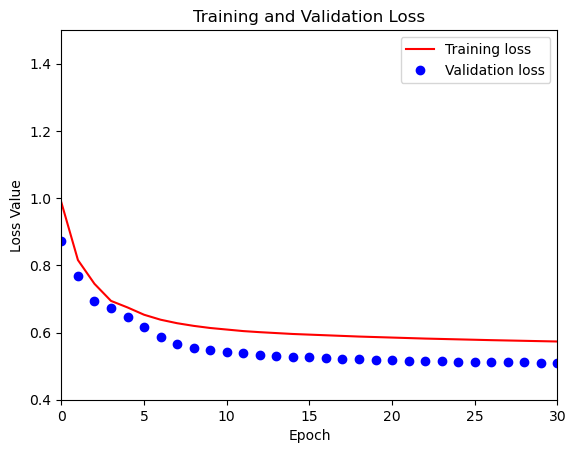

In [5]:
## Training and Validation Loss (L-curve)
import matplotlib.pyplot as plt
# produces L-curve 
loss = unet_model.history.history['loss']
val_loss = unet_model.history.history['val_loss']

plt.figure()
plt.plot( loss, 'r', label='Training loss')
plt.plot( val_loss, 'bo', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss Value')
plt.xlim([0, 30])
plt.ylim([0.4, 1.5])
plt.legend()
plt.show()
#plt.savefig(".png")

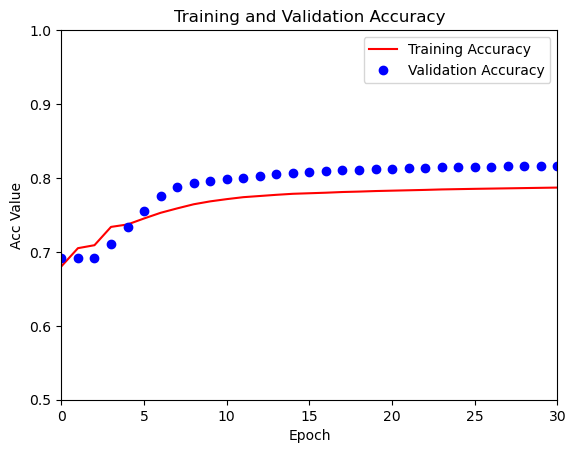

In [6]:
## Training and Validation Accuracy L-curve
acc = unet_model.history.history['sparse_categorical_accuracy']
val_acc = unet_model.history.history['val_sparse_categorical_accuracy']
# produces L-curve (monitor elbow of the L)
plt.figure()
plt.plot( acc, 'r', label='Training Accuracy')
plt.plot( val_acc, 'bo', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Acc Value')
plt.xlim([0, 30])
plt.ylim([0.5, 1])
plt.legend()
plt.show()
#plt.savefig(".png")

In [2]:
# Launch Tensorboard with the appropriate log directory (if subdirectories are not mentioned, then all runs will be displayed)
# Also mention port could be 6007, 6008 onwards. The default is 6006. In case if a tensorboard is already running, use a different port to launch a new instance ig
%tensorboard --logdir crevasse_data --port=6006

### Plot HH-Median Training and Validation Data using Model.Predict

In [5]:
Nov6_T23_25_10 = tf.keras.models.load_model('./crevasse_data/2023-11-06T23-25_10')

In [7]:
training_prediction = unet_model.predict(train_ds.batch(batch_size=1))
from unet import utils
import numpy as np
fig, ax = plt.subplots(20, 3, sharex=True, sharey=True, figsize=(50,200))
dataset = train_ds.map(utils.crop_image_and_label_to_shape(training_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(20)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Image', fontsize='30'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label',fontsize='30'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(training_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction',fontsize='30'); ax[i][2].axis('off')
plt.tight_layout()

20/20 [==============================] - 2s 77ms/step


4/4 [==============================] - 1s 44ms/step


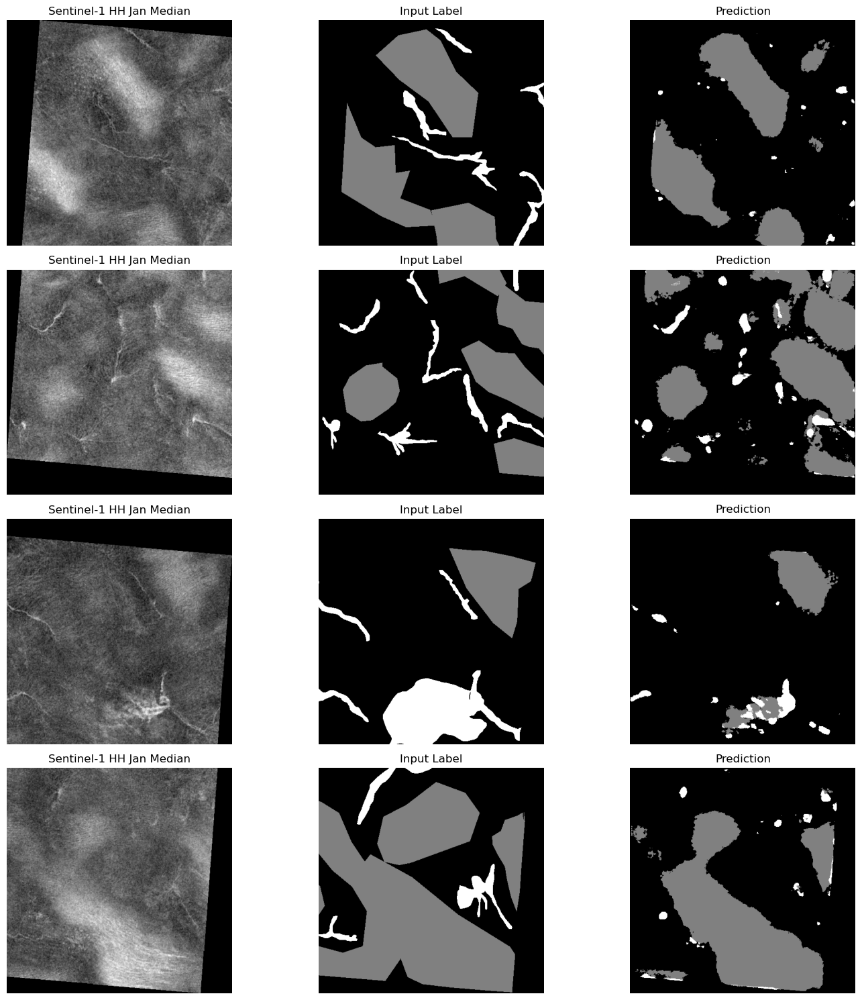

In [8]:
validation_prediction = unet_model.predict(valid_ds.batch(batch_size=1))
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = valid_ds.map(utils.crop_image_and_label_to_shape(validation_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HH Jan Median'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(validation_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

## Test Model Prediction on HH-single, HV-single, HV-median Sentinel-1 Images

In [25]:
# Load HH single images as TF dataset
HH_single_image_dataset = tf.data.Dataset.list_files("./gris/Images_HH_single/Valid/*.png", shuffle=False)
HH_single_image_dataset = HH_single_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load HV single images as TF dataset
HV_single_image_dataset = tf.data.Dataset.list_files("./gris/Images_HV_single/Valid/*.png", shuffle=False)
HV_single_image_dataset = HV_single_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load HV Median images as TF dataset
HV_med_image_dataset = tf.data.Dataset.list_files("./gris/Images_HV_median/Valid/*.png", shuffle=False)
HV_med_image_dataset = HV_med_image_dataset.map(read_image, num_parallel_calls=tf.data.AUTOTUNE)

# Load validation Labels (same labels for all modes)
test_label_dataset = tf.data.Dataset.list_files("./gris/Labels_512/Valid/*.png", shuffle=False)
test_label_dataset = test_label_dataset.map(read_mask, num_parallel_calls=tf.data.AUTOTUNE)

# Zip labels with individual mode image datasets
HH_single_ds = tf.data.Dataset.zip((HH_single_image_dataset,test_label_dataset))
HV_single_ds = tf.data.Dataset.zip((HV_single_image_dataset,test_label_dataset))
HV_med_ds = tf.data.Dataset.zip((HV_med_image_dataset,test_label_dataset))

### HH-single Prediction and Evaluation Metrics

In [26]:
HH_single_prediction = unet_model.predict(HH_single_ds.batch(batch_size=1))
HH_single_evaluation = unet_model.evaluate(HH_single_ds.batch(batch_size=1))

4/4 [==============================] - 0s 70ms/step - loss: 1.0239 - sparse_categorical_accuracy: 0.4148 - sparse_categorical_crossentropy: 1.0239 - io_u_1: 0.7364 - mean_iou: 0.3017 - dice_coefficient: 0.6095


### HV-single Prediction and Evaluation Metrics

In [27]:
HV_single_prediction = unet_model.predict(HV_single_ds.batch(batch_size=1))
HV_single_evaluation = unet_model.evaluate(HV_single_ds.batch(batch_size=1))

4/4 [==============================] - 0s 66ms/step - loss: 1.2011 - sparse_categorical_accuracy: 0.4042 - sparse_categorical_crossentropy: 1.2011 - io_u_1: 0.7364 - mean_iou: 0.3000 - dice_coefficient: 0.6088


### HV-median Prediction and Evaluation Metrics

In [28]:
HV_med_prediction = unet_model.predict(HV_med_ds.batch(batch_size=1))
HV_med_evaluation = unet_model.evaluate(HV_med_ds.batch(batch_size=1))

4/4 [==============================] - 0s 68ms/step - loss: 0.6656 - sparse_categorical_accuracy: 0.6919 - sparse_categorical_crossentropy: 0.6656 - io_u_1: 0.7364 - mean_iou: 0.3043 - dice_coefficient: 0.6093


### Prediction Plot for HH-single images

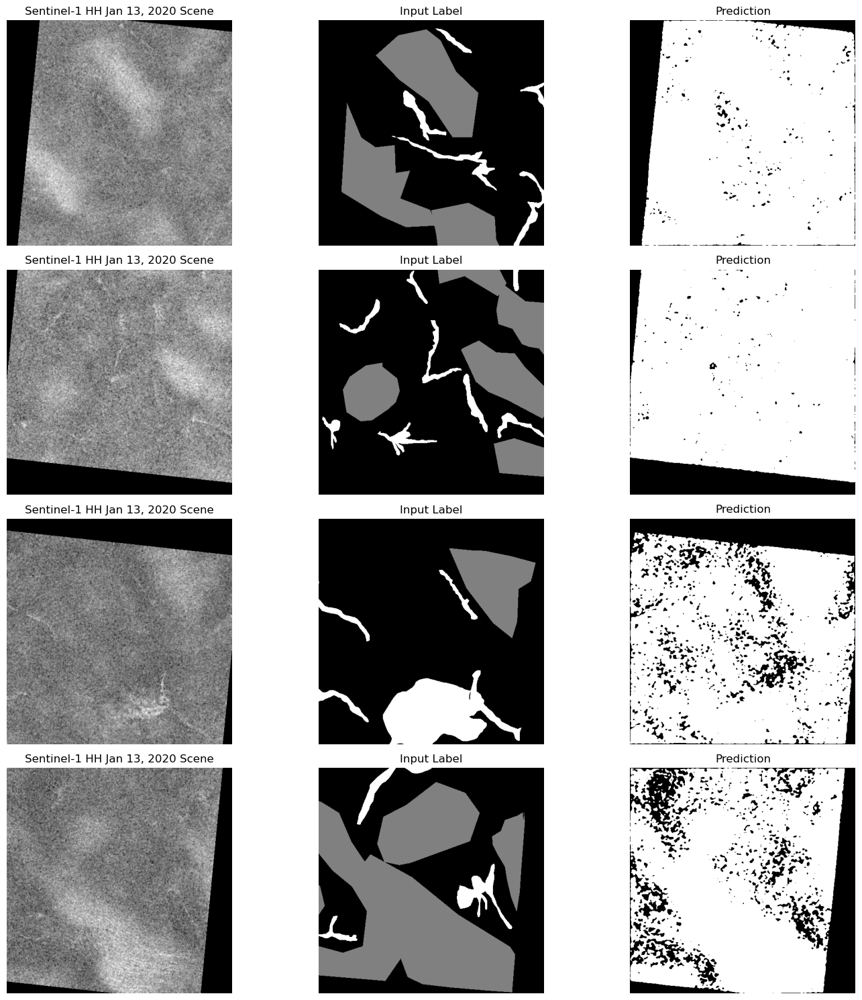

In [43]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HH_single_ds.map(utils.crop_image_and_label_to_shape(HH_single_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HH Jan 13, 2020 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HH_single_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

### Prediction Plot for HV-single images

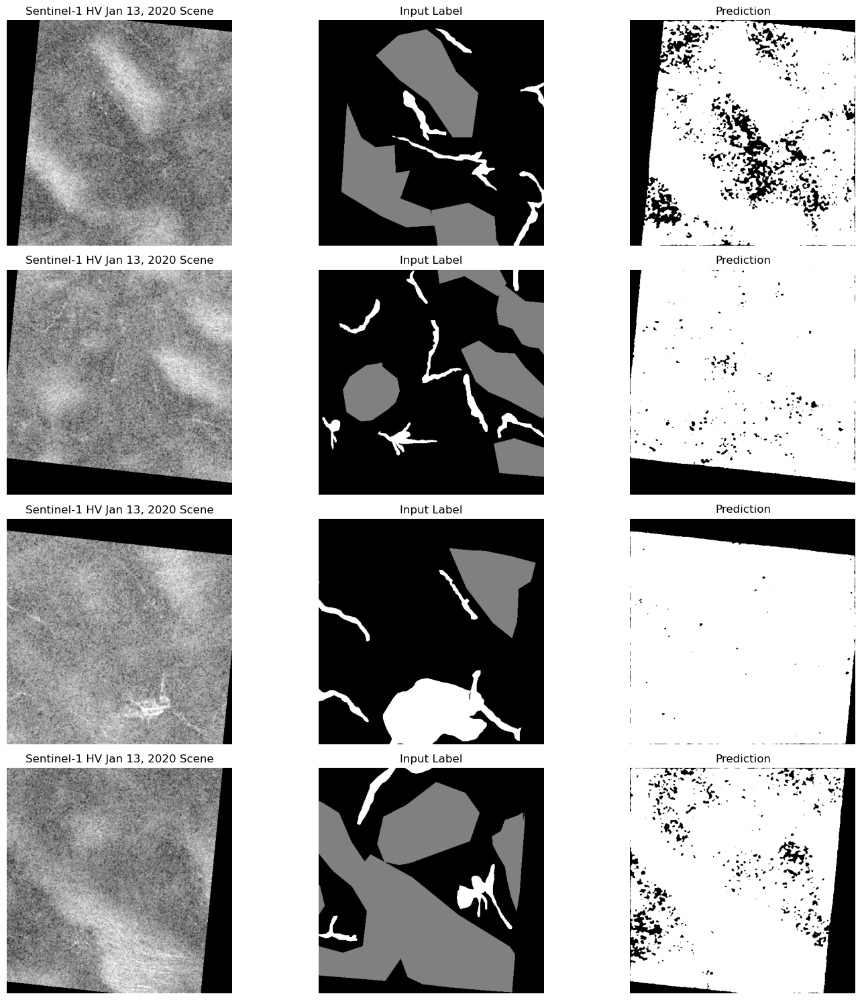

In [44]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HV_single_ds.map(utils.crop_image_and_label_to_shape(HV_single_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HV Jan 13, 2020 Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HV_single_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()

### Prediction Plot for HV-median images

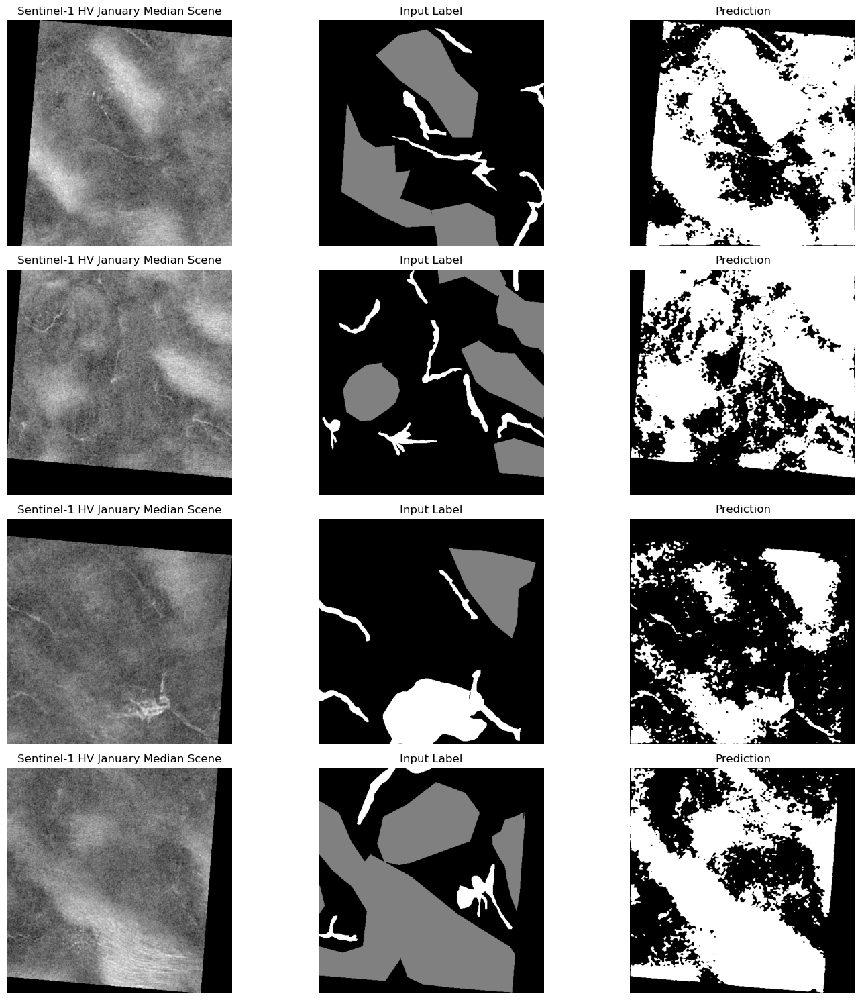

In [45]:
from unet import utils
import numpy as np
fig, ax = plt.subplots(4, 3, sharex=True, sharey=True, figsize=(15,15))
dataset = HV_med_ds.map(utils.crop_image_and_label_to_shape(HV_med_prediction.shape[1:]))

for i, (image, label) in enumerate(dataset.take(4)):
    ax[i][0].imshow(image[..., -1],cmap=plt.cm.gray); ax[i][0].set_title('Sentinel-1 HV January Median Scene'); ax[i][0].axis('off')
    ax[i][1].imshow(label[...],cmap=plt.cm.gray); ax[i][1].set_title('Input Label'); ax[i][1].axis('off')
    ax[i][2].imshow(np.argmax(HV_med_prediction[i,...],axis=-1),cmap=plt.cm.gray); ax[i][2].set_title('Prediction'); ax[i][2].axis('off')
plt.tight_layout()